In [1]:
import os
import numpy as np
import pickle as pkl
import matplotlib.pyplot as plt
import sklearn.metrics
from sklearn.metrics import jaccard_score
import sys
import os
sys.path.append('../src')
import torch
import torchvision
import ds_utils
from patch_ablation_utils import PatchMaster, SuperPixelPatchMaster


In [2]:
sal_map_cls = "/mnt/nfs/home/saachij/src/CausalDomainTransfer/patch_ablation/missingness_results/saliency_maps/resnet_50_sal_map.pkl"
with open(sal_map_cls, 'rb') as f:
    all_saliency_maps = pkl.load(f)

KeyboardInterrupt: 

In [3]:
dataset = ds_utils.ImageNetMegaDS(factor=5)
dataset.saliency = all_saliency_maps

length of DS 10000


NameError: name 'all_saliency_maps' is not defined

In [4]:
pm = PatchMaster('resnet50', patch_size=16)
# dl = ds_utils.get_loader(dataset, bsz=200)

In [5]:
indices = np.arange(0, 10000, 101)

In [6]:
megas = [dataset[idx] for idx in indices]

In [7]:
mega = {}
for k in megas[0].keys():
    print(k)
    mega[k] = torch.stack([torch.tensor(m[k]) for m in megas])

mask
image
labels
idx
saliency_Saliency


<ipython-input-7-fc11d2999e8a>:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mega[k] = torch.stack([torch.tensor(m[k]) for m in megas])


In [8]:
resnet = ds_utils.get_full_model('resnet50', None)
transformer = ds_utils.get_full_model('deit_small_resnet_aug', None)

/data/theory/robustopt/hadi_shared_results/imagenet_experiments/opensource_models/resnet50_l2_eps0.ckpt
=> loading checkpoint '/data/theory/robustopt/hadi_shared_results/imagenet_experiments/opensource_models/resnet50_l2_eps0.ckpt'
=> loaded checkpoint '/data/theory/robustopt/hadi_shared_results/imagenet_experiments/opensource_models/resnet50_l2_eps0.ckpt' (epoch 90)
Loaded robustness lib model
CUDA available: True
Device count: 1
GeForce GTX 1080 Ti
deep-gpu-5              Thu Sep 30 13:58:19 2021  460.91.03
[0] GeForce GTX 1080 Ti | 84'C,  95 % |  6501 / 11178 MB | spark(6497M)
[1] GeForce GTX 1080 Ti | 86'C,  90 % |  6505 / 11178 MB | spark(6501M)
[2] GeForce GTX 1080 Ti | 33'C,   0 % |     1 / 11178 MB |
[3] GeForce GTX 1080 Ti | 45'C,   6 % |  1125 / 11178 MB | saachij(1121M)
[4] GeForce GTX 1080 Ti | 88'C,  98 % |  7895 / 11178 MB | saachij(7891M)
[5] GeForce GTX 1080 Ti | 30'C,   0 % |     1 / 11178 MB |
[6] GeForce GTX 1080 Ti | 82'C,  58 % |  7289 / 11178 MB | saachij(7285M)
[

In [9]:
def process_img(x, patch_orders=None, nums_to_exclude=100):
    results = {}
    orig_inp = ds_utils.TRANSFORM_NORMALIZE(x).cuda()
    
    if patch_orders is None:
        out = transformer(orig_inp)
    else:
        patch_masks = pm.get_patch_masks(patch_orders, nums_to_exclude).cuda()
        out = transformer(orig_inp, patch_mask=patch_masks)    
    out = torch.softmax(out, 1)
    results['transformer'] = out.argmax(-1).cpu()
    
    if patch_orders is None:
        orig_masked = x
    else:
        orig_masked = pm.mask_images(patch_orders, nums_to_exclude, x, filler_value=(0,0,0))
        
    inp = ds_utils.TRANSFORM_NORMALIZE(orig_masked).cuda()
    out = resnet(inp)
    out = torch.softmax(out, 1)
    results['resnet'] = out.argmax(-1).cpu()
    results['img'] = orig_masked
    return results

nums_to_exclude = 75  
    
with torch.no_grad():
    x, y =  mega['image'], mega['labels']
    original_result = process_img(x)
    
    patch_orders = pm.generate_random_patch_orders(x.shape[0])
    random_result = process_img(x, patch_orders, nums_to_exclude)
    
    S = mega[f"saliency_Saliency"]
    flattened_sal_map, patch_orders = pm.get_patch_ordering(S)
    if torch.is_tensor(patch_orders):
        patch_orders = patch_orders.numpy()
    patch_orders = torch.tensor(patch_orders)
    forward_result = process_img(x, patch_orders, nums_to_exclude)
    
    S = mega[f"saliency_Saliency"]
    flattened_sal_map, patch_orders = pm.get_patch_ordering(S)
    if torch.is_tensor(patch_orders):
        patch_orders = patch_orders.numpy()
    patch_orders = patch_orders[:, ::-1].copy()
    patch_orders = torch.tensor(patch_orders)
    reverse_result = process_img(x, patch_orders, nums_to_exclude)

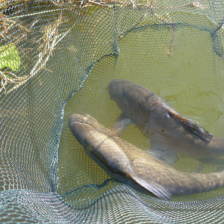

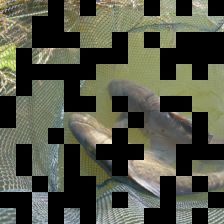

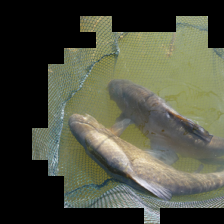

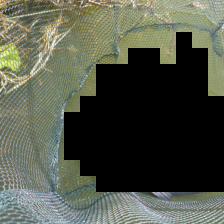

GT: tench, Tinca tinca
Original. Transformer sturgeon,  ResNet sturgeon
Random. Transformer sturgeon,  ResNet crossword puzzle, crossword
Reverse. Transformer sturgeon,  ResNet sturgeon
Forward. Transformer stingray,  ResNet chainlink fence


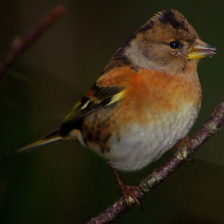

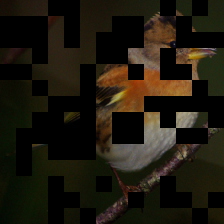

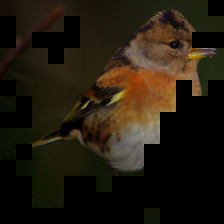

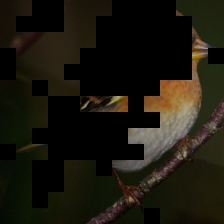

GT: brambling, Fringilla montifringilla
Original. Transformer brambling, Fringilla montifringilla,  ResNet brambling, Fringilla montifringilla
Random. Transformer brambling, Fringilla montifringilla,  ResNet maze, labyrinth
Reverse. Transformer brambling, Fringilla montifringilla,  ResNet brambling, Fringilla montifringilla
Forward. Transformer brambling, Fringilla montifringilla,  ResNet wall clock


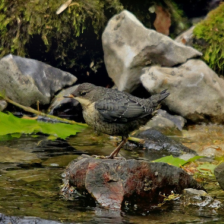

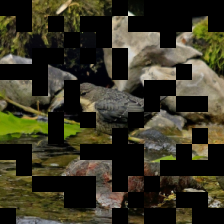

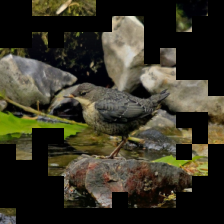

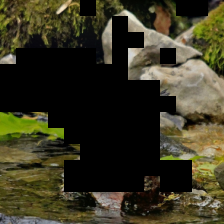

GT: water ouzel, dipper
Original. Transformer water ouzel, dipper,  ResNet water ouzel, dipper
Random. Transformer water ouzel, dipper,  ResNet maze, labyrinth
Reverse. Transformer water ouzel, dipper,  ResNet water ouzel, dipper
Forward. Transformer water ouzel, dipper,  ResNet church, church building


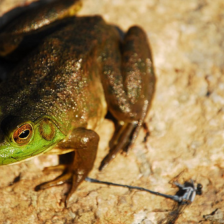

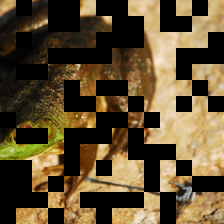

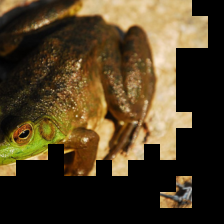

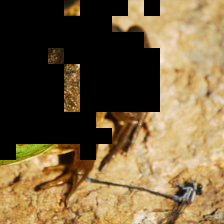

GT: bullfrog, Rana catesbeiana
Original. Transformer bullfrog, Rana catesbeiana,  ResNet bullfrog, Rana catesbeiana
Random. Transformer bullfrog, Rana catesbeiana,  ResNet maze, labyrinth
Reverse. Transformer bullfrog, Rana catesbeiana,  ResNet bullfrog, Rana catesbeiana
Forward. Transformer cricket,  ResNet castle


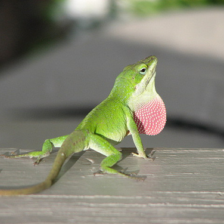

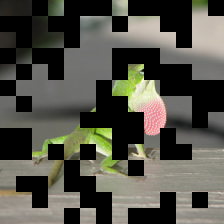

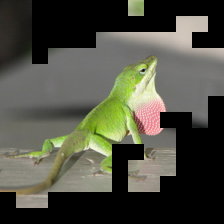

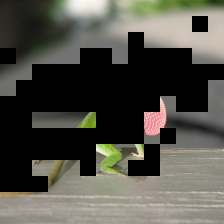

GT: American chameleon, anole, Anolis carolinensis
Original. Transformer American chameleon, anole, Anolis carolinensis,  ResNet American chameleon, anole, Anolis carolinensis
Random. Transformer American chameleon, anole, Anolis carolinensis,  ResNet maze, labyrinth
Reverse. Transformer American chameleon, anole, Anolis carolinensis,  ResNet green lizard, Lacerta viridis
Forward. Transformer American chameleon, anole, Anolis carolinensis,  ResNet carton


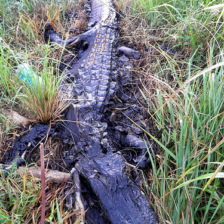

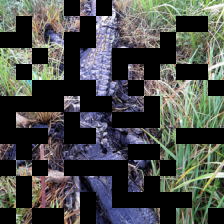

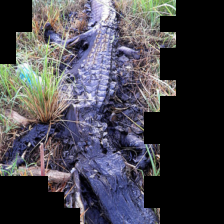

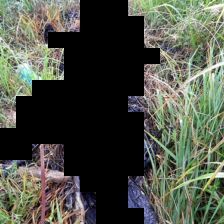

GT: American alligator, Alligator mississipiensis
Original. Transformer American alligator, Alligator mississipiensis,  ResNet African crocodile, Nile crocodile, Crocodylus niloticus
Random. Transformer African crocodile, Nile crocodile, Crocodylus niloticus,  ResNet maze, labyrinth
Reverse. Transformer American alligator, Alligator mississipiensis,  ResNet African crocodile, Nile crocodile, Crocodylus niloticus
Forward. Transformer crayfish, crawfish, crawdad, crawdaddy,  ResNet lumbermill, sawmill


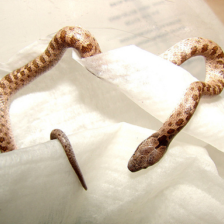

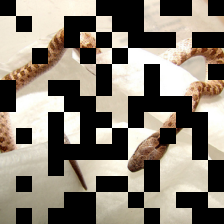

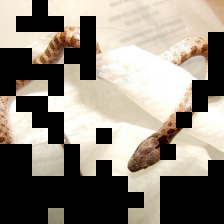

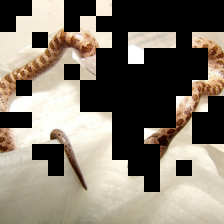

GT: night snake, Hypsiglena torquata
Original. Transformer boa constrictor, Constrictor constrictor,  ResNet night snake, Hypsiglena torquata
Random. Transformer boa constrictor, Constrictor constrictor,  ResNet crossword puzzle, crossword
Reverse. Transformer boa constrictor, Constrictor constrictor,  ResNet envelope
Forward. Transformer horned viper, cerastes, sand viper, horned asp, Cerastes cornutus,  ResNet envelope


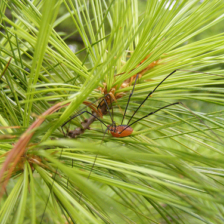

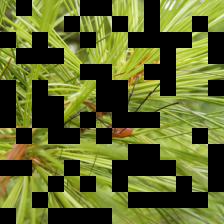

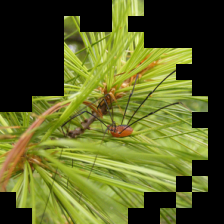

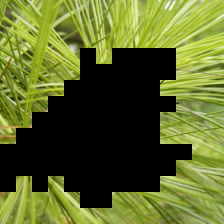

GT: harvestman, daddy longlegs, Phalangium opilio
Original. Transformer harvestman, daddy longlegs, Phalangium opilio,  ResNet harvestman, daddy longlegs, Phalangium opilio
Random. Transformer eft,  ResNet maze, labyrinth
Reverse. Transformer harvestman, daddy longlegs, Phalangium opilio,  ResNet umbrella
Forward. Transformer polecat, fitch, foulmart, foumart, Mustela putorius,  ResNet church, church building


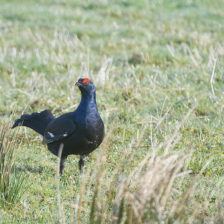

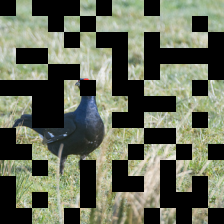

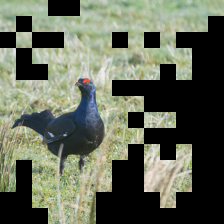

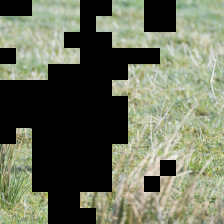

GT: black grouse
Original. Transformer black grouse,  ResNet black grouse
Random. Transformer black grouse,  ResNet crossword puzzle, crossword
Reverse. Transformer black grouse,  ResNet black grouse
Forward. Transformer wombat,  ResNet barn


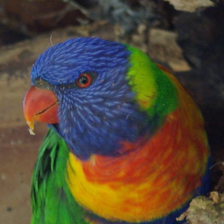

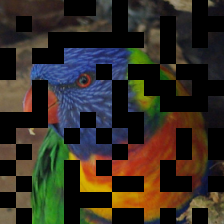

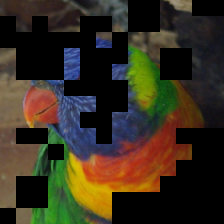

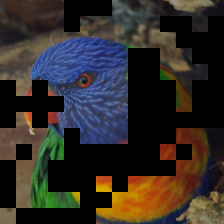

GT: lorikeet
Original. Transformer lorikeet,  ResNet lorikeet
Random. Transformer lorikeet,  ResNet maze, labyrinth
Reverse. Transformer lorikeet,  ResNet jigsaw puzzle
Forward. Transformer lorikeet,  ResNet maze, labyrinth


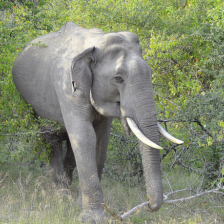

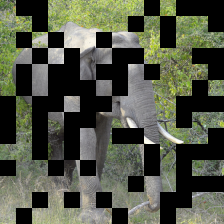

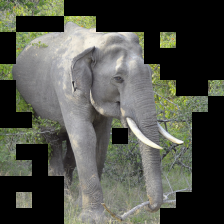

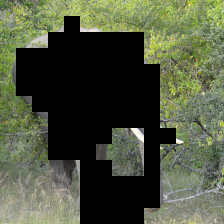

GT: tusker
Original. Transformer tusker,  ResNet tusker
Random. Transformer tusker,  ResNet maze, labyrinth
Reverse. Transformer tusker,  ResNet tusker
Forward. Transformer tusker,  ResNet church, church building


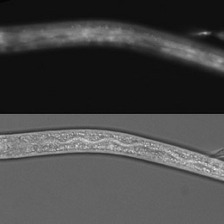

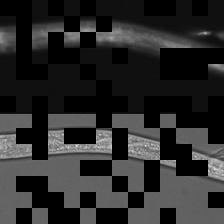

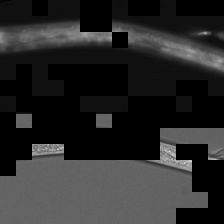

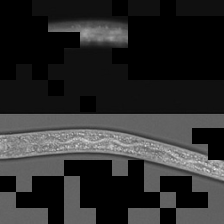

GT: nematode, nematode worm, roundworm
Original. Transformer nematode, nematode worm, roundworm,  ResNet nematode, nematode worm, roundworm
Random. Transformer nematode, nematode worm, roundworm,  ResNet crossword puzzle, crossword
Reverse. Transformer nematode, nematode worm, roundworm,  ResNet traffic light, traffic signal, stoplight
Forward. Transformer nematode, nematode worm, roundworm,  ResNet maze, labyrinth


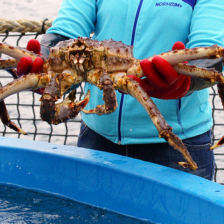

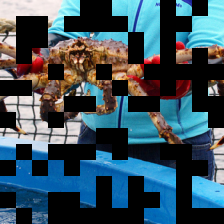

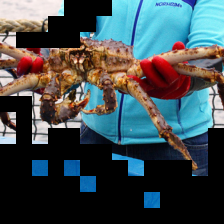

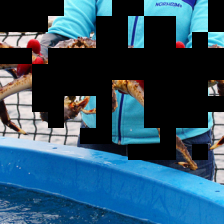

GT: king crab, Alaska crab, Alaskan king crab, Alaska king crab, Paralithodes camtschatica
Original. Transformer king crab, Alaska crab, Alaskan king crab, Alaska king crab, Paralithodes camtschatica,  ResNet king crab, Alaska crab, Alaskan king crab, Alaska king crab, Paralithodes camtschatica
Random. Transformer king crab, Alaska crab, Alaskan king crab, Alaska king crab, Paralithodes camtschatica,  ResNet envelope
Reverse. Transformer king crab, Alaska crab, Alaskan king crab, Alaska king crab, Paralithodes camtschatica,  ResNet king crab, Alaska crab, Alaskan king crab, Alaska king crab, Paralithodes camtschatica
Forward. Transformer king crab, Alaska crab, Alaskan king crab, Alaska king crab, Paralithodes camtschatica,  ResNet sea lion


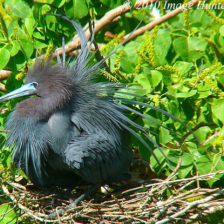

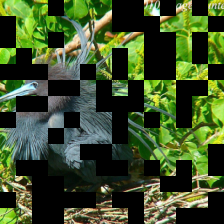

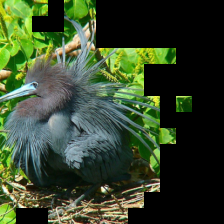

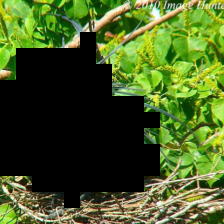

GT: little blue heron, Egretta caerulea
Original. Transformer little blue heron, Egretta caerulea,  ResNet little blue heron, Egretta caerulea
Random. Transformer little blue heron, Egretta caerulea,  ResNet carton
Reverse. Transformer little blue heron, Egretta caerulea,  ResNet little blue heron, Egretta caerulea
Forward. Transformer little blue heron, Egretta caerulea,  ResNet birdhouse


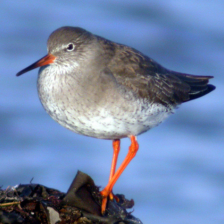

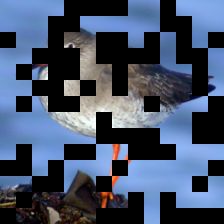

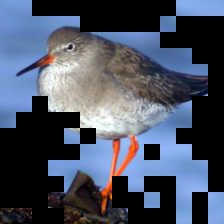

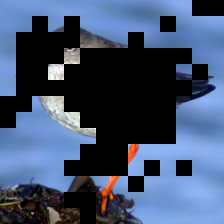

GT: redshank, Tringa totanus
Original. Transformer redshank, Tringa totanus,  ResNet redshank, Tringa totanus
Random. Transformer redshank, Tringa totanus,  ResNet jigsaw puzzle
Reverse. Transformer redshank, Tringa totanus,  ResNet redshank, Tringa totanus
Forward. Transformer redshank, Tringa totanus,  ResNet jigsaw puzzle


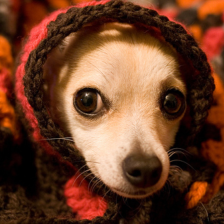

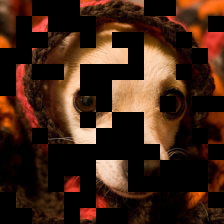

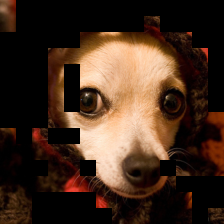

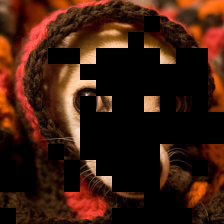

GT: Chihuahua
Original. Transformer Chihuahua,  ResNet Chihuahua
Random. Transformer Chihuahua,  ResNet padlock
Reverse. Transformer Chihuahua,  ResNet Chihuahua
Forward. Transformer bonnet, poke bonnet,  ResNet revolver, six-gun, six-shooter


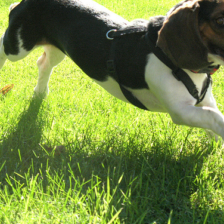

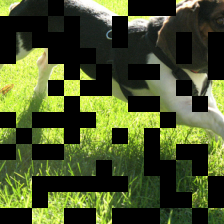

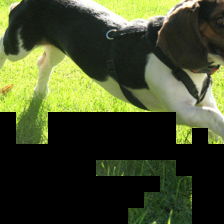

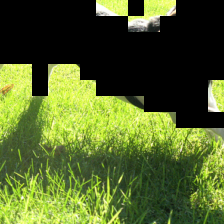

GT: basset, basset hound
Original. Transformer Lakeland terrier,  ResNet Walker hound, Walker foxhound
Random. Transformer Walker hound, Walker foxhound,  ResNet maze, labyrinth
Reverse. Transformer Walker hound, Walker foxhound,  ResNet beagle
Forward. Transformer crane,  ResNet picket fence, paling


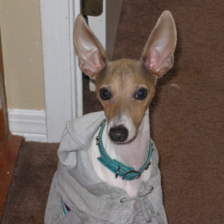

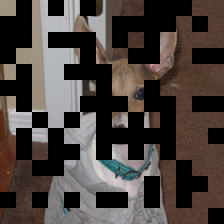

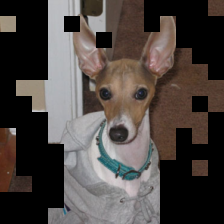

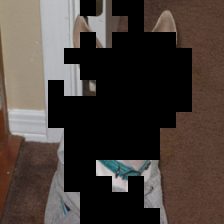

GT: Italian greyhound
Original. Transformer toy terrier,  ResNet Italian greyhound
Random. Transformer space heater,  ResNet maze, labyrinth
Reverse. Transformer Italian greyhound,  ResNet Italian greyhound
Forward. Transformer vacuum, vacuum cleaner,  ResNet carton


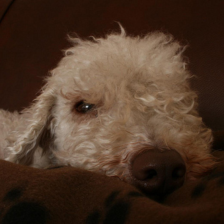

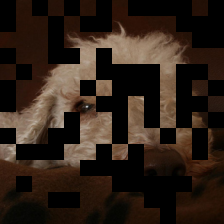

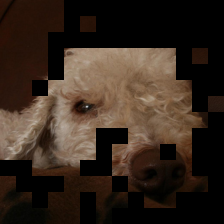

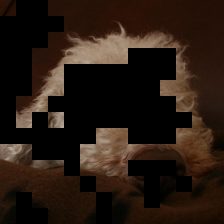

GT: Bedlington terrier
Original. Transformer Bedlington terrier,  ResNet Bedlington terrier
Random. Transformer Bedlington terrier,  ResNet maze, labyrinth
Reverse. Transformer Bedlington terrier,  ResNet teddy, teddy bear
Forward. Transformer Bedlington terrier,  ResNet church, church building


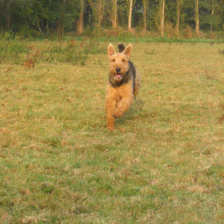

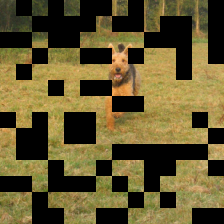

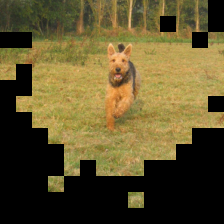

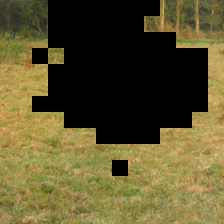

GT: Airedale, Airedale terrier
Original. Transformer Airedale, Airedale terrier,  ResNet Airedale, Airedale terrier
Random. Transformer Airedale, Airedale terrier,  ResNet crossword puzzle, crossword
Reverse. Transformer Airedale, Airedale terrier,  ResNet Australian terrier
Forward. Transformer Scotch terrier, Scottish terrier, Scottie,  ResNet barn


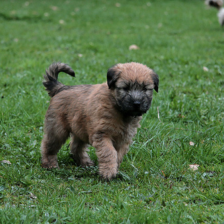

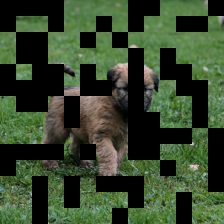

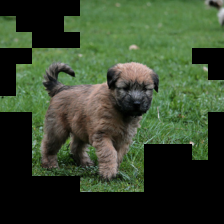

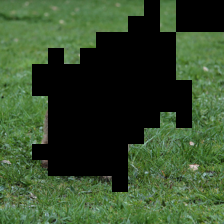

GT: soft-coated wheaten terrier
Original. Transformer soft-coated wheaten terrier,  ResNet soft-coated wheaten terrier
Random. Transformer soft-coated wheaten terrier,  ResNet maze, labyrinth
Reverse. Transformer soft-coated wheaten terrier,  ResNet Brabancon griffon
Forward. Transformer West Highland white terrier,  ResNet apiary, bee house


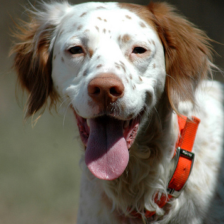

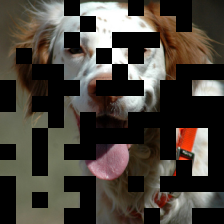

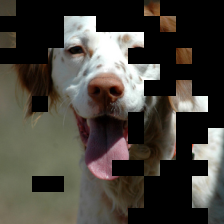

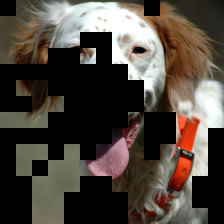

GT: English setter
Original. Transformer English setter,  ResNet Brittany spaniel
Random. Transformer English setter,  ResNet quilt, comforter, comfort, puff
Reverse. Transformer English setter,  ResNet Brittany spaniel
Forward. Transformer English setter,  ResNet English setter


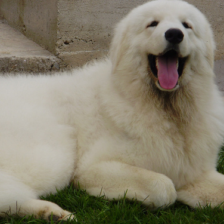

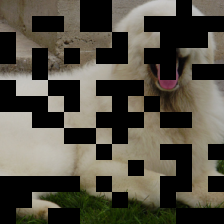

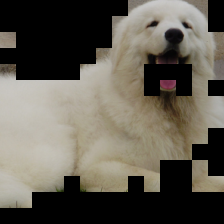

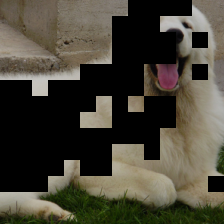

GT: kuvasz
Original. Transformer Great Pyrenees,  ResNet Samoyed, Samoyede
Random. Transformer Samoyed, Samoyede,  ResNet maze, labyrinth
Reverse. Transformer Great Pyrenees,  ResNet kuvasz
Forward. Transformer Samoyed, Samoyede,  ResNet maze, labyrinth


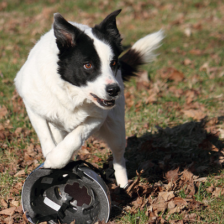

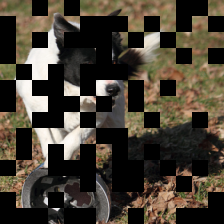

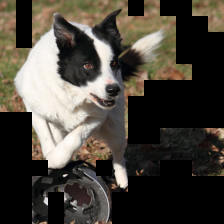

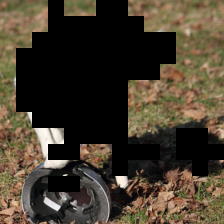

GT: Border collie
Original. Transformer Border collie,  ResNet Border collie
Random. Transformer Border collie,  ResNet maze, labyrinth
Reverse. Transformer Border collie,  ResNet Border collie
Forward. Transformer tricycle, trike, velocipede,  ResNet shovel


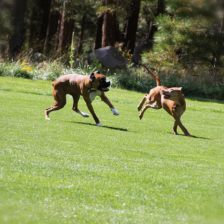

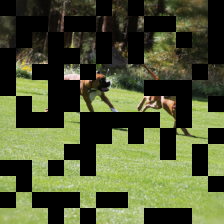

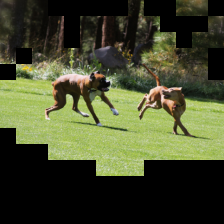

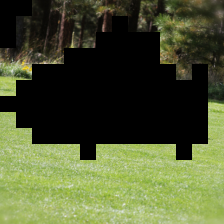

GT: boxer
Original. Transformer Rhodesian ridgeback,  ResNet Rhodesian ridgeback
Random. Transformer Rhodesian ridgeback,  ResNet maze, labyrinth
Reverse. Transformer Rhodesian ridgeback,  ResNet Rhodesian ridgeback
Forward. Transformer hare,  ResNet church, church building


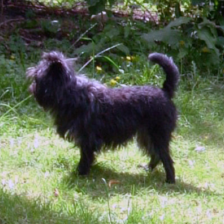

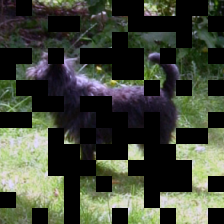

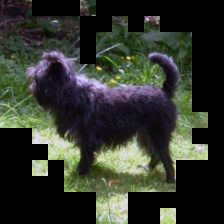

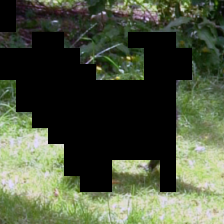

GT: affenpinscher, monkey pinscher, monkey dog
Original. Transformer affenpinscher, monkey pinscher, monkey dog,  ResNet affenpinscher, monkey pinscher, monkey dog
Random. Transformer affenpinscher, monkey pinscher, monkey dog,  ResNet maze, labyrinth
Reverse. Transformer affenpinscher, monkey pinscher, monkey dog,  ResNet affenpinscher, monkey pinscher, monkey dog
Forward. Transformer grey fox, gray fox, Urocyon cinereoargenteus,  ResNet barn


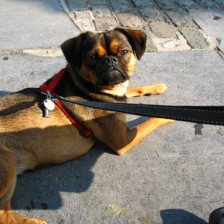

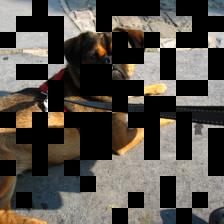

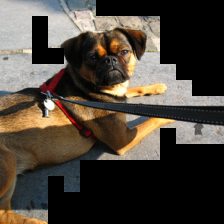

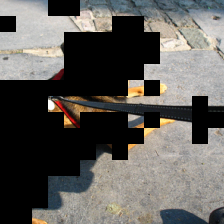

GT: Brabancon griffon
Original. Transformer Brabancon griffon,  ResNet Brabancon griffon
Random. Transformer German shepherd, German shepherd dog, German police dog, alsatian,  ResNet maze, labyrinth
Reverse. Transformer Brabancon griffon,  ResNet Brabancon griffon
Forward. Transformer knot,  ResNet carton


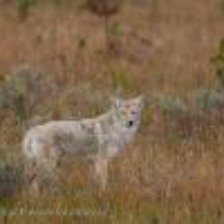

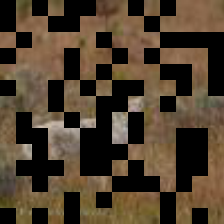

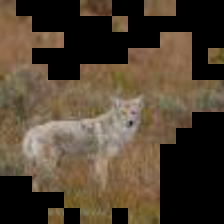

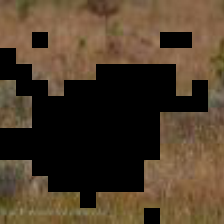

GT: coyote, prairie wolf, brush wolf, Canis latrans
Original. Transformer coyote, prairie wolf, brush wolf, Canis latrans,  ResNet coyote, prairie wolf, brush wolf, Canis latrans
Random. Transformer brown bear, bruin, Ursus arctos,  ResNet crossword puzzle, crossword
Reverse. Transformer coyote, prairie wolf, brush wolf, Canis latrans,  ResNet coyote, prairie wolf, brush wolf, Canis latrans
Forward. Transformer hartebeest,  ResNet barn


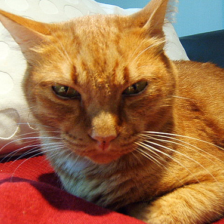

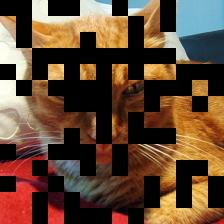

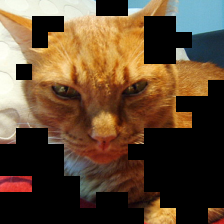

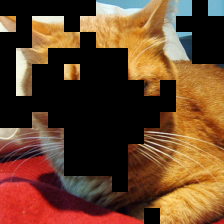

GT: tiger cat
Original. Transformer tiger cat,  ResNet Egyptian cat
Random. Transformer tiger cat,  ResNet maze, labyrinth
Reverse. Transformer tiger cat,  ResNet envelope
Forward. Transformer tiger cat,  ResNet jigsaw puzzle


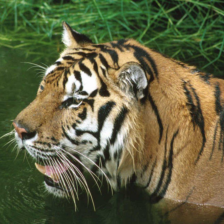

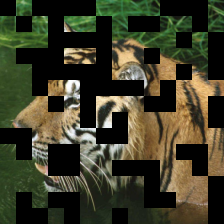

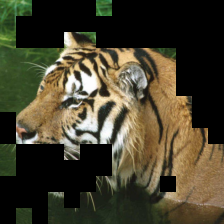

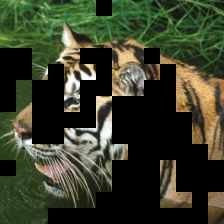

GT: tiger, Panthera tigris
Original. Transformer tiger, Panthera tigris,  ResNet tiger, Panthera tigris
Random. Transformer tiger, Panthera tigris,  ResNet wall clock
Reverse. Transformer tiger, Panthera tigris,  ResNet tiger, Panthera tigris
Forward. Transformer tiger, Panthera tigris,  ResNet carton


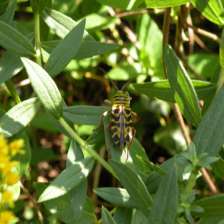

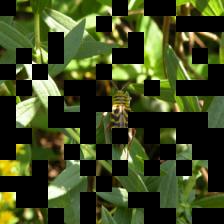

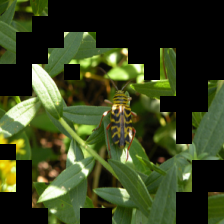

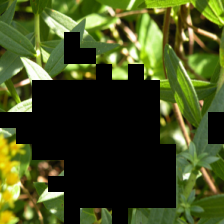

GT: long-horned beetle, longicorn, longicorn beetle
Original. Transformer long-horned beetle, longicorn, longicorn beetle,  ResNet leaf beetle, chrysomelid
Random. Transformer bee,  ResNet maze, labyrinth
Reverse. Transformer bee,  ResNet bee
Forward. Transformer daisy,  ResNet loudspeaker, speaker, speaker unit, loudspeaker system, speaker system


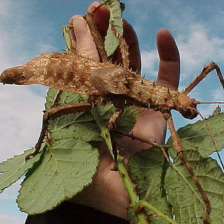

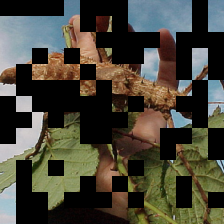

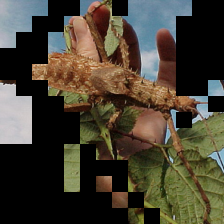

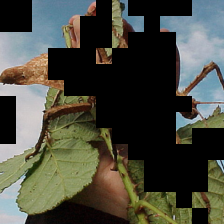

GT: walking stick, walkingstick, stick insect
Original. Transformer walking stick, walkingstick, stick insect,  ResNet walking stick, walkingstick, stick insect
Random. Transformer walking stick, walkingstick, stick insect,  ResNet maze, labyrinth
Reverse. Transformer walking stick, walkingstick, stick insect,  ResNet chain saw, chainsaw
Forward. Transformer walking stick, walkingstick, stick insect,  ResNet birdhouse


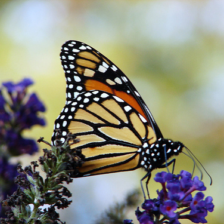

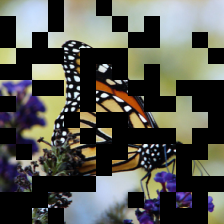

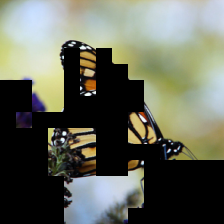

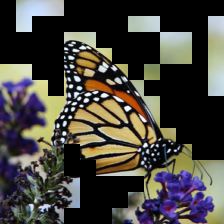

GT: monarch, monarch butterfly, milkweed butterfly, Danaus plexippus
Original. Transformer monarch, monarch butterfly, milkweed butterfly, Danaus plexippus,  ResNet monarch, monarch butterfly, milkweed butterfly, Danaus plexippus
Random. Transformer monarch, monarch butterfly, milkweed butterfly, Danaus plexippus,  ResNet monarch, monarch butterfly, milkweed butterfly, Danaus plexippus
Reverse. Transformer monarch, monarch butterfly, milkweed butterfly, Danaus plexippus,  ResNet crane
Forward. Transformer monarch, monarch butterfly, milkweed butterfly, Danaus plexippus,  ResNet monarch, monarch butterfly, milkweed butterfly, Danaus plexippus


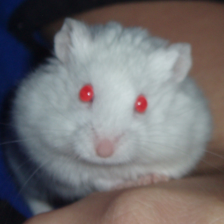

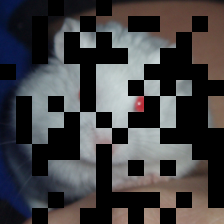

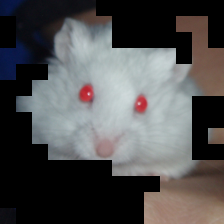

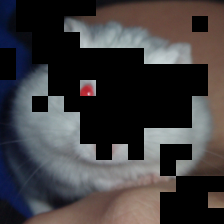

GT: hamster
Original. Transformer hamster,  ResNet hamster
Random. Transformer hamster,  ResNet maze, labyrinth
Reverse. Transformer hamster,  ResNet hamster
Forward. Transformer hamster,  ResNet jigsaw puzzle


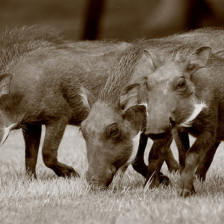

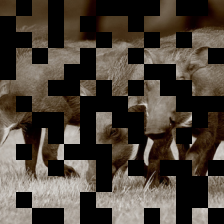

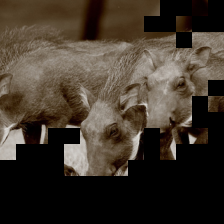

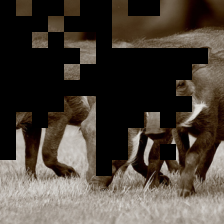

GT: warthog
Original. Transformer bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis,  ResNet warthog
Random. Transformer bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis,  ResNet maze, labyrinth
Reverse. Transformer Indian elephant, Elephas maximus,  ResNet ram, tup
Forward. Transformer bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis,  ResNet hammer


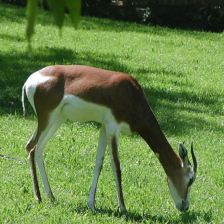

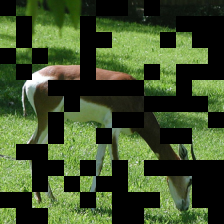

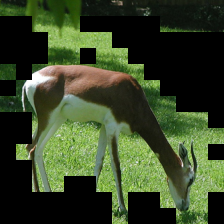

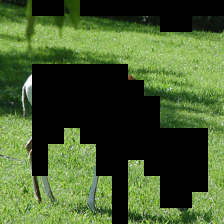

GT: gazelle
Original. Transformer gazelle,  ResNet gazelle
Random. Transformer gazelle,  ResNet maze, labyrinth
Reverse. Transformer gazelle,  ResNet gazelle
Forward. Transformer crane,  ResNet barn


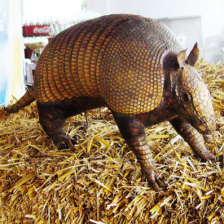

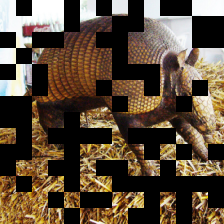

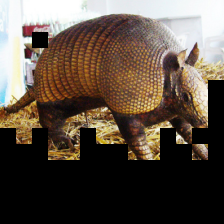

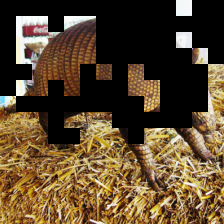

GT: armadillo
Original. Transformer armadillo,  ResNet armadillo
Random. Transformer armadillo,  ResNet jigsaw puzzle
Reverse. Transformer armadillo,  ResNet armadillo
Forward. Transformer armadillo,  ResNet hay


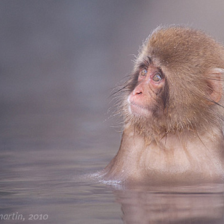

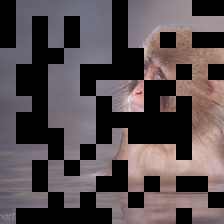

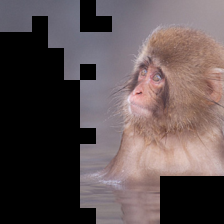

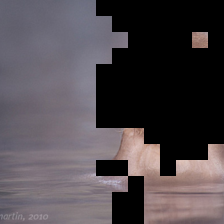

GT: macaque
Original. Transformer macaque,  ResNet macaque
Random. Transformer macaque,  ResNet crossword puzzle, crossword
Reverse. Transformer macaque,  ResNet macaque
Forward. Transformer otter,  ResNet church, church building


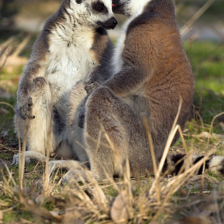

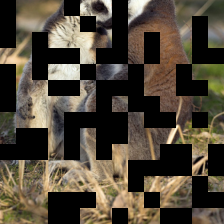

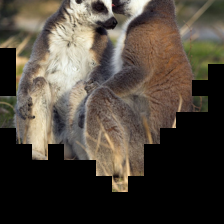

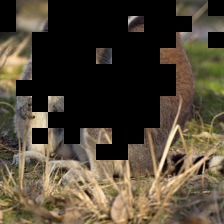

GT: Madagascar cat, ring-tailed lemur, Lemur catta
Original. Transformer Madagascar cat, ring-tailed lemur, Lemur catta,  ResNet Madagascar cat, ring-tailed lemur, Lemur catta
Random. Transformer Madagascar cat, ring-tailed lemur, Lemur catta,  ResNet maze, labyrinth
Reverse. Transformer indri, indris, Indri indri, Indri brevicaudatus,  ResNet Madagascar cat, ring-tailed lemur, Lemur catta
Forward. Transformer Madagascar cat, ring-tailed lemur, Lemur catta,  ResNet barn


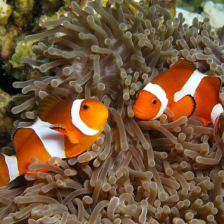

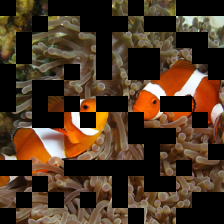

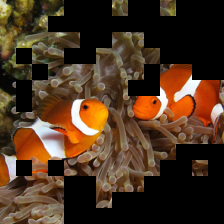

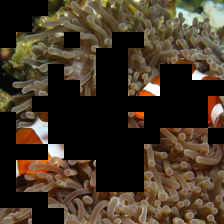

GT: anemone fish
Original. Transformer anemone fish,  ResNet anemone fish
Random. Transformer anemone fish,  ResNet perfume, essence
Reverse. Transformer anemone fish,  ResNet anemone fish
Forward. Transformer anemone fish,  ResNet plane, carpenter's plane, woodworking plane


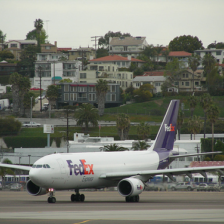

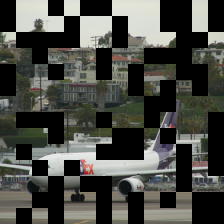

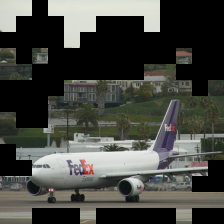

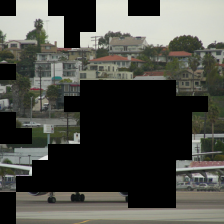

GT: airliner
Original. Transformer airliner,  ResNet airliner
Random. Transformer airliner,  ResNet envelope
Reverse. Transformer airliner,  ResNet warplane, military plane
Forward. Transformer airliner,  ResNet web site, website, internet site, site


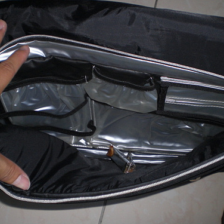

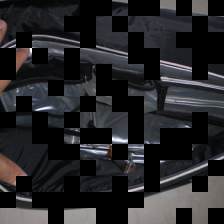

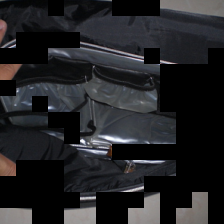

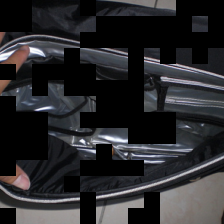

GT: backpack, back pack, knapsack, packsack, rucksack, haversack
Original. Transformer carpenter's kit, tool kit,  ResNet mailbag, postbag
Random. Transformer carpenter's kit, tool kit,  ResNet maze, labyrinth
Reverse. Transformer carpenter's kit, tool kit,  ResNet mortarboard
Forward. Transformer disk brake, disc brake,  ResNet coil, spiral, volute, whorl, helix


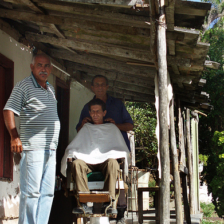

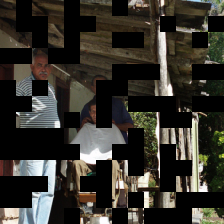

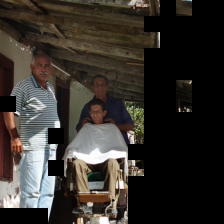

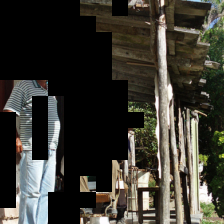

GT: barbershop
Original. Transformer lumbermill, sawmill,  ResNet yurt
Random. Transformer power drill,  ResNet maze, labyrinth
Reverse. Transformer patio, terrace,  ResNet barber chair
Forward. Transformer barrow, garden cart, lawn cart, wheelbarrow,  ResNet accordion, piano accordion, squeeze box


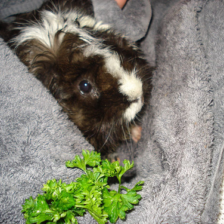

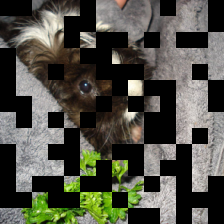

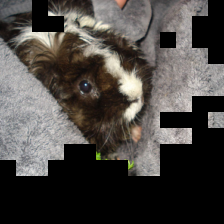

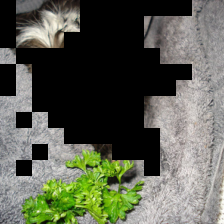

GT: bath towel
Original. Transformer guinea pig, Cavia cobaya,  ResNet guinea pig, Cavia cobaya
Random. Transformer guinea pig, Cavia cobaya,  ResNet crossword puzzle, crossword
Reverse. Transformer guinea pig, Cavia cobaya,  ResNet guinea pig, Cavia cobaya
Forward. Transformer skunk, polecat, wood pussy,  ResNet castle


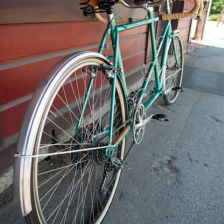

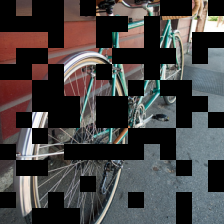

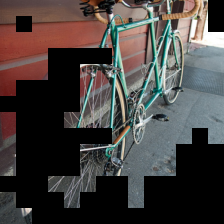

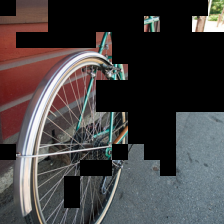

GT: bicycle-built-for-two, tandem bicycle, tandem
Original. Transformer bicycle-built-for-two, tandem bicycle, tandem,  ResNet bicycle-built-for-two, tandem bicycle, tandem
Random. Transformer bicycle-built-for-two, tandem bicycle, tandem,  ResNet umbrella
Reverse. Transformer bicycle-built-for-two, tandem bicycle, tandem,  ResNet bicycle-built-for-two, tandem bicycle, tandem
Forward. Transformer bicycle-built-for-two, tandem bicycle, tandem,  ResNet unicycle, monocycle


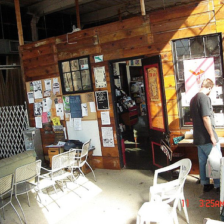

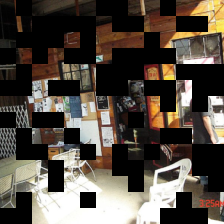

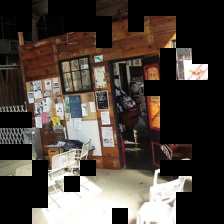

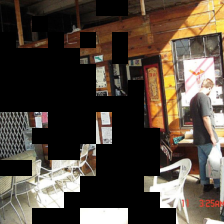

GT: bookshop, bookstore, bookstall
Original. Transformer bookshop, bookstore, bookstall,  ResNet bookshop, bookstore, bookstall
Random. Transformer restaurant, eating house, eating place, eatery,  ResNet bookshop, bookstore, bookstall
Reverse. Transformer restaurant, eating house, eating place, eatery,  ResNet bookshop, bookstore, bookstall
Forward. Transformer bookshop, bookstore, bookstall,  ResNet bookshop, bookstore, bookstall


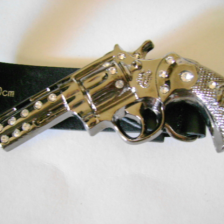

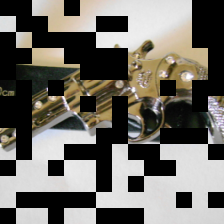

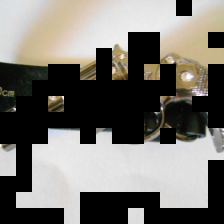

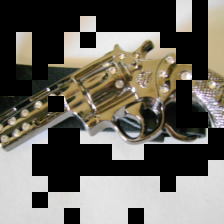

GT: buckle
Original. Transformer oboe, hautboy, hautbois,  ResNet hair slide
Random. Transformer sax, saxophone,  ResNet loupe, jeweler's loupe
Reverse. Transformer fountain pen,  ResNet padlock
Forward. Transformer hair slide,  ResNet can opener, tin opener


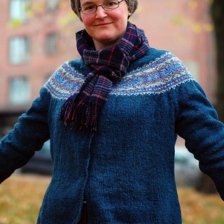

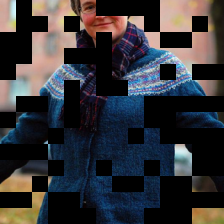

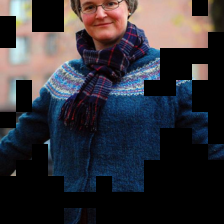

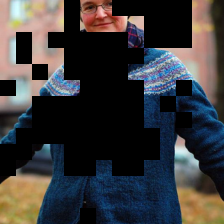

GT: cardigan
Original. Transformer stole,  ResNet cardigan
Random. Transformer stole,  ResNet carton
Reverse. Transformer stole,  ResNet stole
Forward. Transformer cardigan,  ResNet rifle


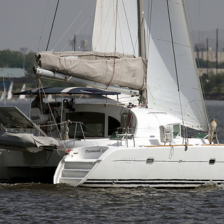

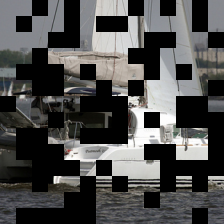

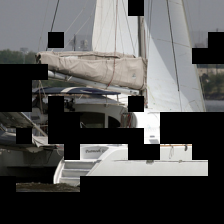

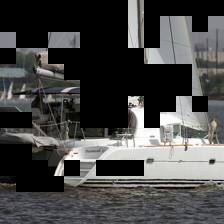

GT: catamaran
Original. Transformer catamaran,  ResNet catamaran
Random. Transformer trimaran,  ResNet crossword puzzle, crossword
Reverse. Transformer trimaran,  ResNet trimaran
Forward. Transformer catamaran,  ResNet trimaran


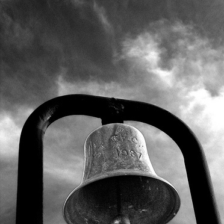

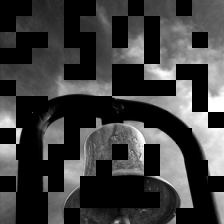

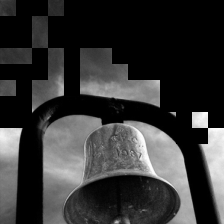

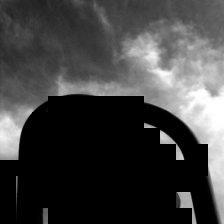

GT: chime, bell, gong
Original. Transformer chime, bell, gong,  ResNet chime, bell, gong
Random. Transformer chime, bell, gong,  ResNet padlock
Reverse. Transformer chime, bell, gong,  ResNet chime, bell, gong
Forward. Transformer rocking chair, rocker,  ResNet barn


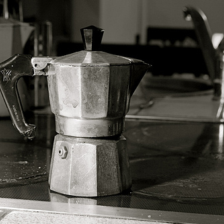

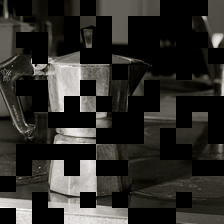

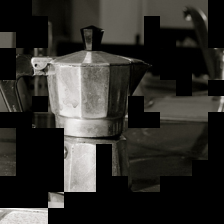

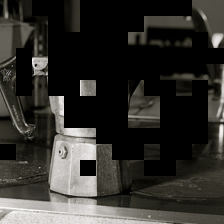

GT: coffeepot
Original. Transformer coffeepot,  ResNet coffeepot
Random. Transformer coffeepot,  ResNet coffeepot
Reverse. Transformer coffeepot,  ResNet coffeepot
Forward. Transformer coffeepot,  ResNet coffeepot


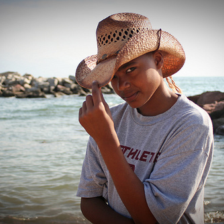

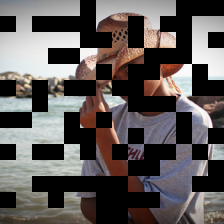

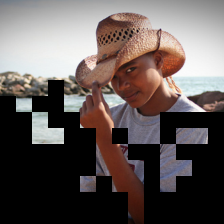

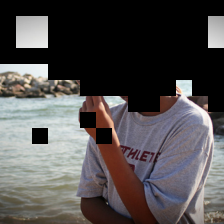

GT: cowboy hat, ten-gallon hat
Original. Transformer sea urchin,  ResNet cowboy hat, ten-gallon hat
Random. Transformer sea urchin,  ResNet crossword puzzle, crossword
Reverse. Transformer sea urchin,  ResNet cowboy hat, ten-gallon hat
Forward. Transformer sombrero,  ResNet bassoon


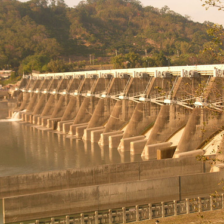

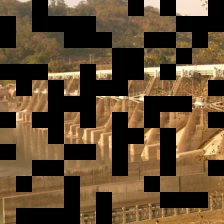

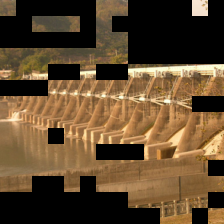

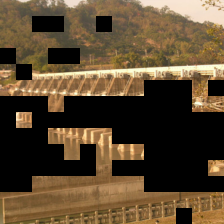

GT: dam, dike, dyke
Original. Transformer dam, dike, dyke,  ResNet dam, dike, dyke
Random. Transformer dam, dike, dyke,  ResNet maze, labyrinth
Reverse. Transformer dam, dike, dyke,  ResNet fountain
Forward. Transformer dam, dike, dyke,  ResNet maze, labyrinth


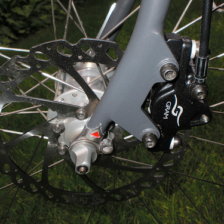

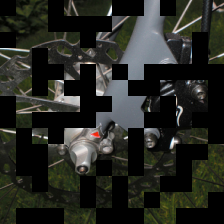

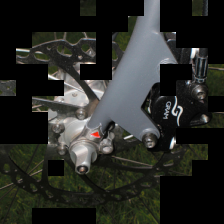

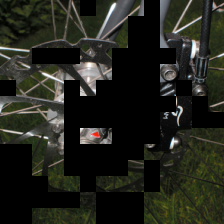

GT: disk brake, disc brake
Original. Transformer disk brake, disc brake,  ResNet disk brake, disc brake
Random. Transformer disk brake, disc brake,  ResNet padlock
Reverse. Transformer disk brake, disc brake,  ResNet projectile, missile
Forward. Transformer disk brake, disc brake,  ResNet padlock


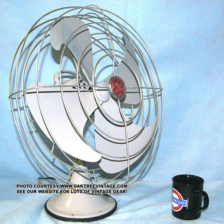

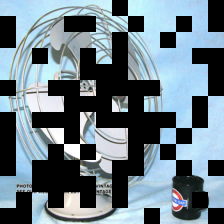

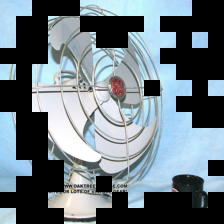

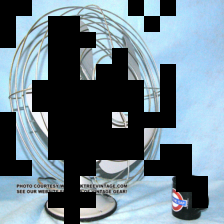

GT: electric fan, blower
Original. Transformer electric fan, blower,  ResNet electric fan, blower
Random. Transformer electric fan, blower,  ResNet crossword puzzle, crossword
Reverse. Transformer electric fan, blower,  ResNet electric fan, blower
Forward. Transformer electric fan, blower,  ResNet perfume, essence


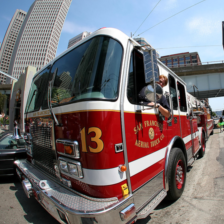

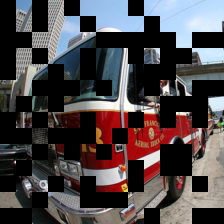

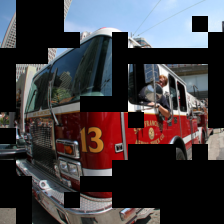

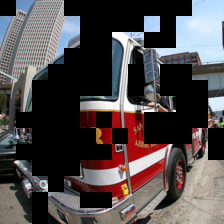

GT: fire engine, fire truck
Original. Transformer fire engine, fire truck,  ResNet fire engine, fire truck
Random. Transformer fire engine, fire truck,  ResNet fire engine, fire truck
Reverse. Transformer fire engine, fire truck,  ResNet fire engine, fire truck
Forward. Transformer fire engine, fire truck,  ResNet fire engine, fire truck


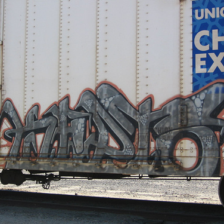

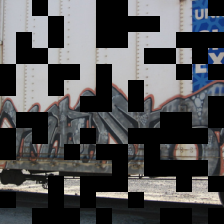

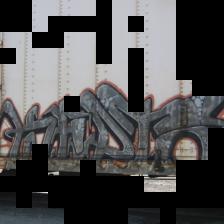

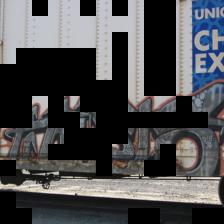

GT: freight car
Original. Transformer freight car,  ResNet freight car
Random. Transformer freight car,  ResNet crossword puzzle, crossword
Reverse. Transformer freight car,  ResNet freight car
Forward. Transformer freight car,  ResNet freight car


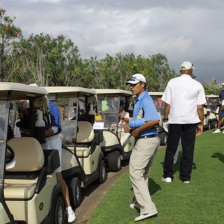

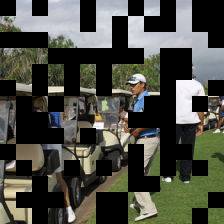

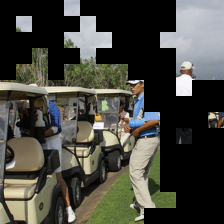

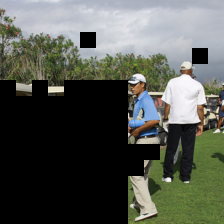

GT: golfcart, golf cart
Original. Transformer golfcart, golf cart,  ResNet golfcart, golf cart
Random. Transformer golfcart, golf cart,  ResNet carton
Reverse. Transformer golfcart, golf cart,  ResNet golfcart, golf cart
Forward. Transformer stretcher,  ResNet mortarboard


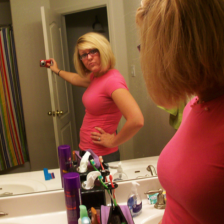

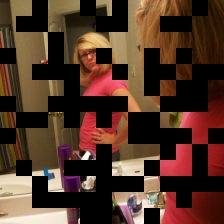

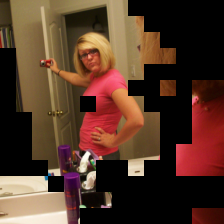

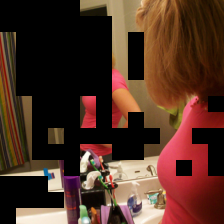

GT: hair spray
Original. Transformer hair spray,  ResNet plunger, plumber's helper
Random. Transformer hair spray,  ResNet carton
Reverse. Transformer hair spray,  ResNet plunger, plumber's helper
Forward. Transformer hair spray,  ResNet refrigerator, icebox


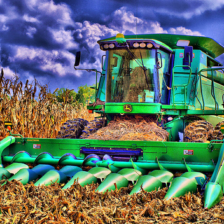

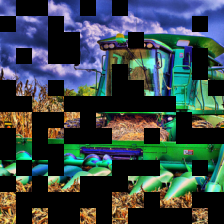

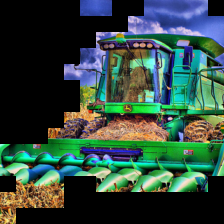

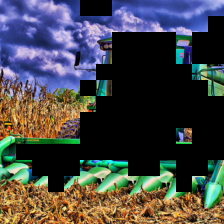

GT: harvester, reaper
Original. Transformer harvester, reaper,  ResNet harvester, reaper
Random. Transformer harvester, reaper,  ResNet monitor
Reverse. Transformer harvester, reaper,  ResNet harvester, reaper
Forward. Transformer plow, plough,  ResNet plow, plough


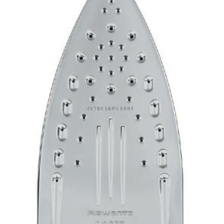

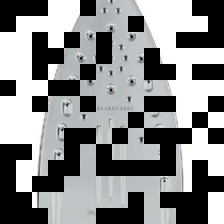

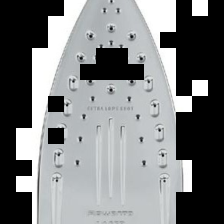

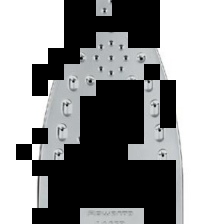

GT: iron, smoothing iron
Original. Transformer iron, smoothing iron,  ResNet iron, smoothing iron
Random. Transformer iron, smoothing iron,  ResNet crossword puzzle, crossword
Reverse. Transformer iron, smoothing iron,  ResNet iron, smoothing iron
Forward. Transformer iron, smoothing iron,  ResNet crossword puzzle, crossword


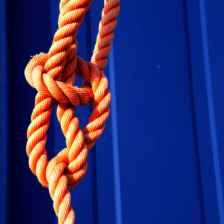

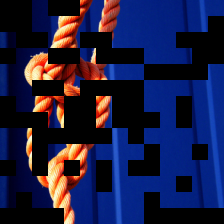

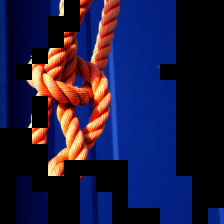

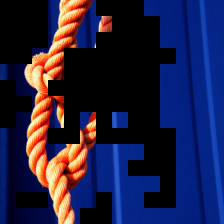

GT: knot
Original. Transformer knot,  ResNet knot
Random. Transformer knot,  ResNet maze, labyrinth
Reverse. Transformer knot,  ResNet knot
Forward. Transformer knot,  ResNet knot


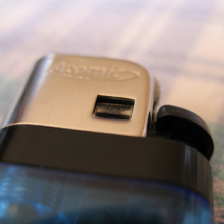

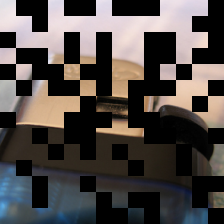

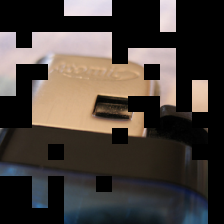

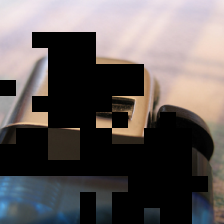

GT: lighter, light, igniter, ignitor
Original. Transformer digital watch,  ResNet lighter, light, igniter, ignitor
Random. Transformer iPod,  ResNet maze, labyrinth
Reverse. Transformer digital watch,  ResNet envelope
Forward. Transformer iPod,  ResNet church, church building


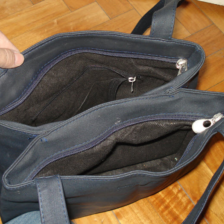

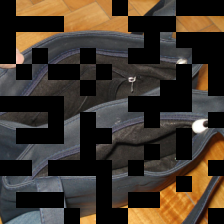

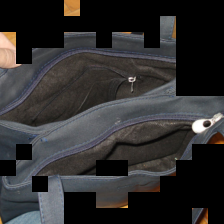

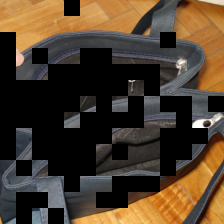

GT: mailbag, postbag
Original. Transformer backpack, back pack, knapsack, packsack, rucksack, haversack,  ResNet backpack, back pack, knapsack, packsack, rucksack, haversack
Random. Transformer backpack, back pack, knapsack, packsack, rucksack, haversack,  ResNet maze, labyrinth
Reverse. Transformer backpack, back pack, knapsack, packsack, rucksack, haversack,  ResNet neck brace
Forward. Transformer muzzle,  ResNet plane, carpenter's plane, woodworking plane


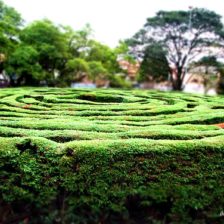

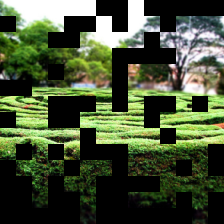

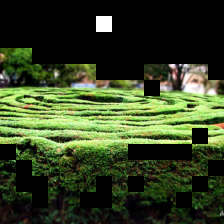

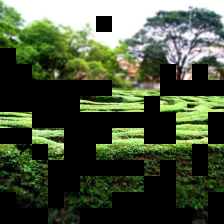

GT: maze, labyrinth
Original. Transformer maze, labyrinth,  ResNet maze, labyrinth
Random. Transformer maze, labyrinth,  ResNet maze, labyrinth
Reverse. Transformer maze, labyrinth,  ResNet maze, labyrinth
Forward. Transformer maze, labyrinth,  ResNet maze, labyrinth


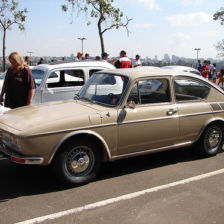

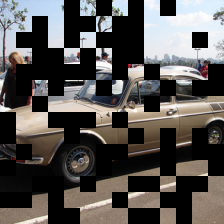

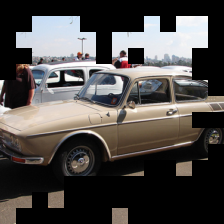

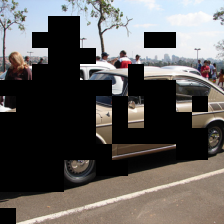

GT: minivan
Original. Transformer beach wagon, station wagon, wagon, estate car, beach waggon, station waggon, waggon,  ResNet beach wagon, station wagon, wagon, estate car, beach waggon, station waggon, waggon
Random. Transformer beach wagon, station wagon, wagon, estate car, beach waggon, station waggon, waggon,  ResNet desk
Reverse. Transformer beach wagon, station wagon, wagon, estate car, beach waggon, station waggon, waggon,  ResNet cab, hack, taxi, taxicab
Forward. Transformer limousine, limo,  ResNet home theater, home theatre


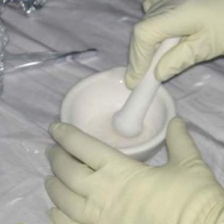

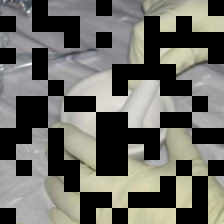

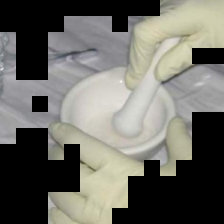

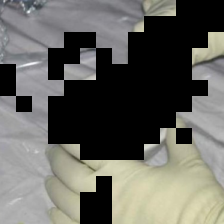

GT: mortar
Original. Transformer dough,  ResNet mortar
Random. Transformer trifle,  ResNet toilet tissue, toilet paper, bathroom tissue
Reverse. Transformer trifle,  ResNet mortar
Forward. Transformer dough,  ResNet quilt, comforter, comfort, puff


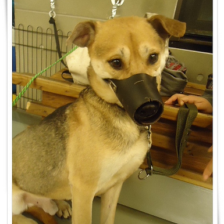

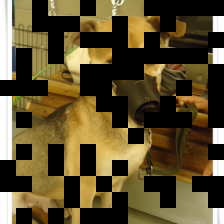

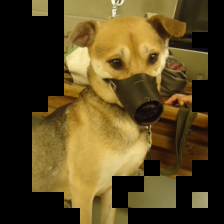

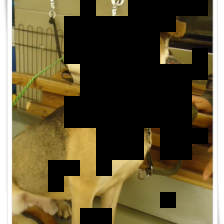

GT: muzzle
Original. Transformer muzzle,  ResNet muzzle
Random. Transformer muzzle,  ResNet maze, labyrinth
Reverse. Transformer muzzle,  ResNet muzzle
Forward. Transformer Siberian husky,  ResNet carton


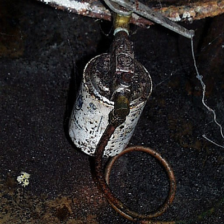

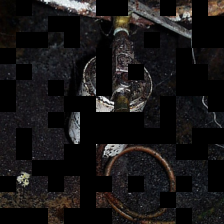

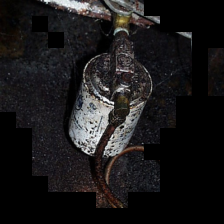

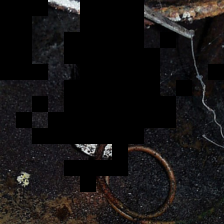

GT: oil filter
Original. Transformer boa constrictor, Constrictor constrictor,  ResNet iron, smoothing iron
Random. Transformer dragonfly, darning needle, devil's darning needle, sewing needle, snake feeder, snake doctor, mosquito hawk, skeeter hawk,  ResNet padlock
Reverse. Transformer whistle,  ResNet perfume, essence
Forward. Transformer common newt, Triturus vulgaris,  ResNet guillotine


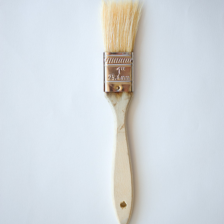

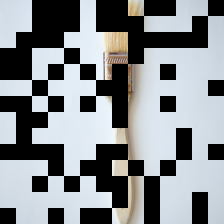

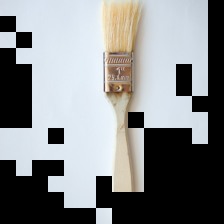

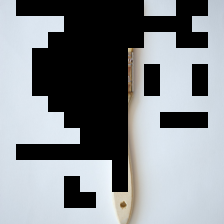

GT: paintbrush
Original. Transformer paintbrush,  ResNet paintbrush
Random. Transformer paintbrush,  ResNet crossword puzzle, crossword
Reverse. Transformer paintbrush,  ResNet paintbrush
Forward. Transformer paintbrush,  ResNet rule, ruler


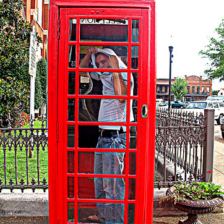

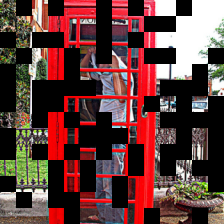

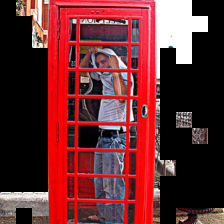

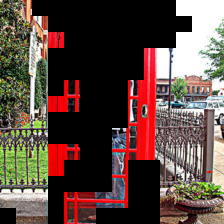

GT: pay-phone, pay-station
Original. Transformer pay-phone, pay-station,  ResNet pay-phone, pay-station
Random. Transformer pay-phone, pay-station,  ResNet barn
Reverse. Transformer pay-phone, pay-station,  ResNet pay-phone, pay-station
Forward. Transformer abacus,  ResNet guillotine


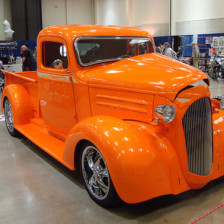

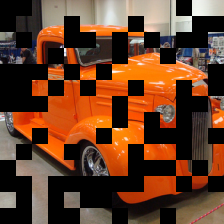

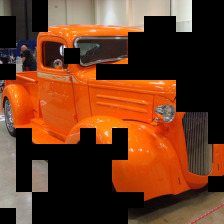

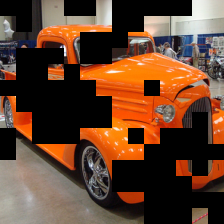

GT: pickup, pickup truck
Original. Transformer pickup, pickup truck,  ResNet pickup, pickup truck
Random. Transformer pickup, pickup truck,  ResNet maze, labyrinth
Reverse. Transformer pickup, pickup truck,  ResNet pickup, pickup truck
Forward. Transformer pickup, pickup truck,  ResNet sports car, sport car


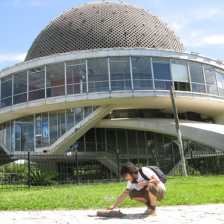

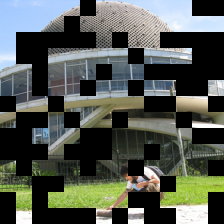

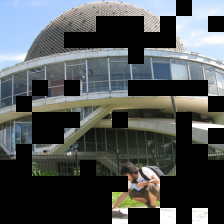

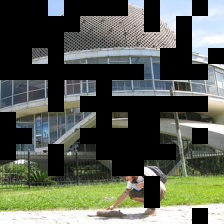

GT: planetarium
Original. Transformer planetarium,  ResNet planetarium
Random. Transformer planetarium,  ResNet dome
Reverse. Transformer planetarium,  ResNet planetarium
Forward. Transformer planetarium,  ResNet digital clock


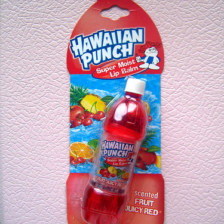

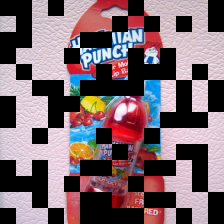

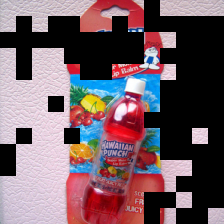

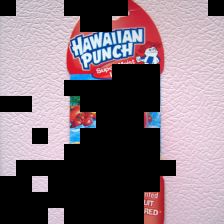

GT: pop bottle, soda bottle
Original. Transformer soap dispenser,  ResNet packet
Random. Transformer ballpoint, ballpoint pen, ballpen, Biro,  ResNet crossword puzzle, crossword
Reverse. Transformer ballpoint, ballpoint pen, ballpen, Biro,  ResNet pop bottle, soda bottle
Forward. Transformer wall clock,  ResNet envelope


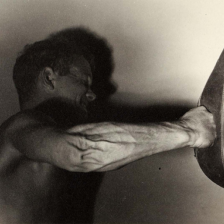

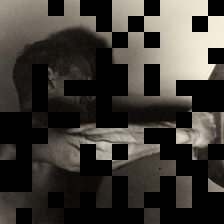

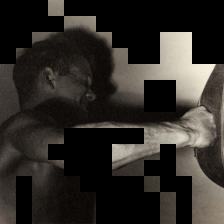

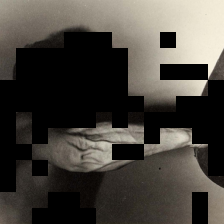

GT: punching bag, punch bag, punching ball, punchball
Original. Transformer siamang, Hylobates syndactylus, Symphalangus syndactylus,  ResNet punching bag, punch bag, punching ball, punchball
Random. Transformer gibbon, Hylobates lar,  ResNet maze, labyrinth
Reverse. Transformer Rottweiler,  ResNet plunger, plumber's helper
Forward. Transformer cowboy hat, ten-gallon hat,  ResNet carton


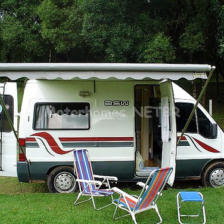

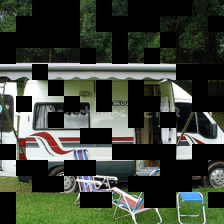

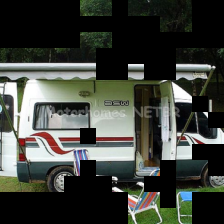

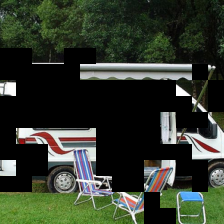

GT: recreational vehicle, RV, R.V.
Original. Transformer recreational vehicle, RV, R.V.,  ResNet recreational vehicle, RV, R.V.
Random. Transformer recreational vehicle, RV, R.V.,  ResNet folding chair
Reverse. Transformer recreational vehicle, RV, R.V.,  ResNet recreational vehicle, RV, R.V.
Forward. Transformer recreational vehicle, RV, R.V.,  ResNet barbershop


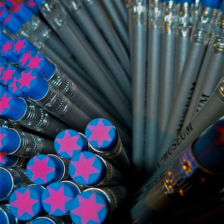

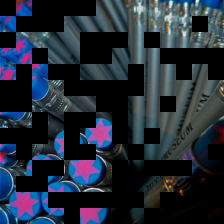

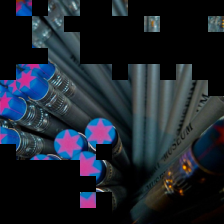

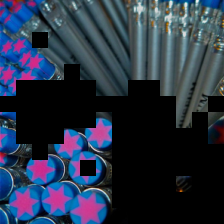

GT: rubber eraser, rubber, pencil eraser
Original. Transformer rubber eraser, rubber, pencil eraser,  ResNet rubber eraser, rubber, pencil eraser
Random. Transformer rubber eraser, rubber, pencil eraser,  ResNet perfume, essence
Reverse. Transformer rubber eraser, rubber, pencil eraser,  ResNet microphone, mike
Forward. Transformer balloon,  ResNet organ, pipe organ


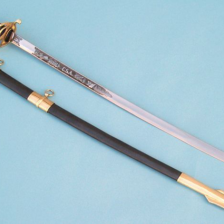

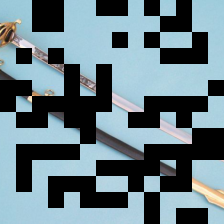

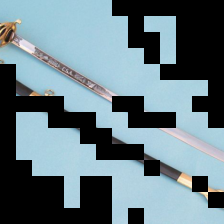

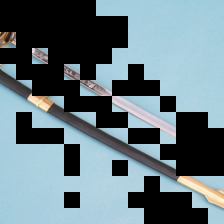

GT: scabbard
Original. Transformer scabbard,  ResNet scabbard
Random. Transformer scabbard,  ResNet crossword puzzle, crossword
Reverse. Transformer scabbard,  ResNet rule, ruler
Forward. Transformer scabbard,  ResNet envelope


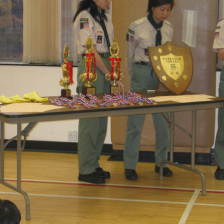

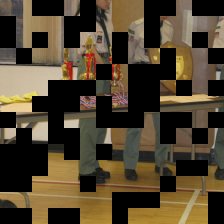

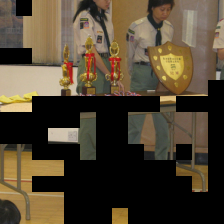

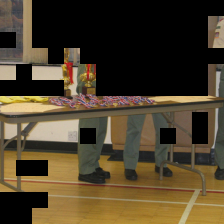

GT: shield, buckler
Original. Transformer candle, taper, wax light,  ResNet French horn, horn
Random. Transformer stretcher,  ResNet maze, labyrinth
Reverse. Transformer stretcher,  ResNet vestment
Forward. Transformer dining table, board,  ResNet home theater, home theatre


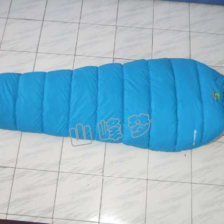

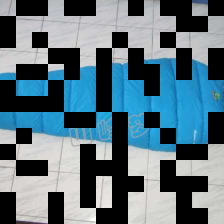

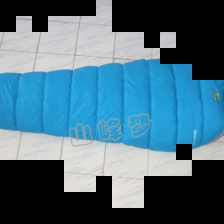

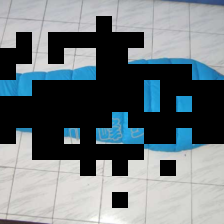

GT: sleeping bag
Original. Transformer sleeping bag,  ResNet sleeping bag
Random. Transformer sleeping bag,  ResNet crossword puzzle, crossword
Reverse. Transformer sleeping bag,  ResNet sleeping bag
Forward. Transformer stretcher,  ResNet crossword puzzle, crossword


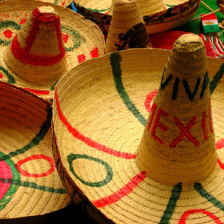

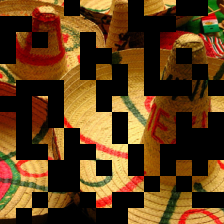

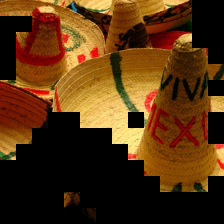

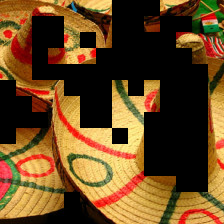

GT: sombrero
Original. Transformer sombrero,  ResNet sombrero
Random. Transformer sombrero,  ResNet maze, labyrinth
Reverse. Transformer sombrero,  ResNet sombrero
Forward. Transformer sombrero,  ResNet wine bottle


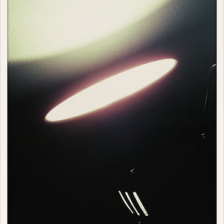

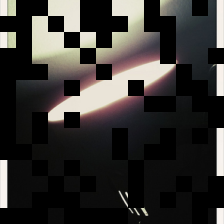

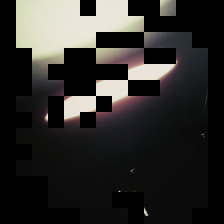

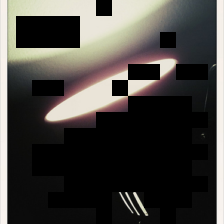

GT: spotlight, spot
Original. Transformer spotlight, spot,  ResNet spotlight, spot
Random. Transformer candle, taper, wax light,  ResNet maze, labyrinth
Reverse. Transformer spotlight, spot,  ResNet maze, labyrinth
Forward. Transformer red wine,  ResNet traffic light, traffic signal, stoplight


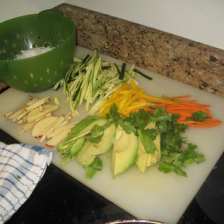

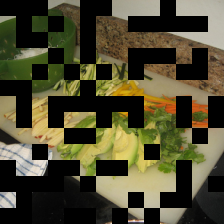

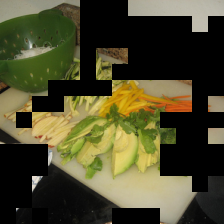

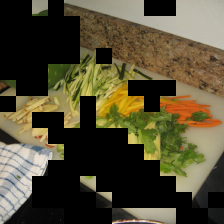

GT: strainer
Original. Transformer cucumber, cuke,  ResNet zucchini, courgette
Random. Transformer cucumber, cuke,  ResNet maze, labyrinth
Reverse. Transformer cucumber, cuke,  ResNet Granny Smith
Forward. Transformer spaghetti squash,  ResNet church, church building


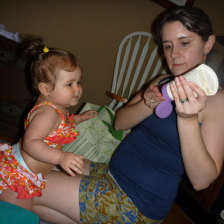

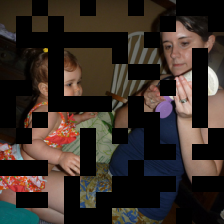

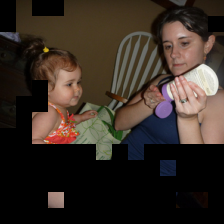

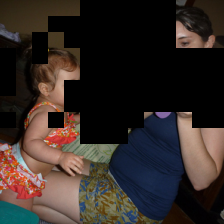

GT: sunscreen, sunblock, sun blocker
Original. Transformer Band Aid,  ResNet spatula
Random. Transformer Band Aid,  ResNet envelope
Reverse. Transformer Band Aid,  ResNet groom, bridegroom
Forward. Transformer harmonica, mouth organ, harp, mouth harp,  ResNet bikini, two-piece


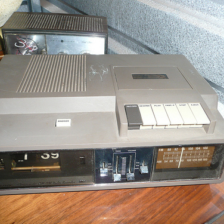

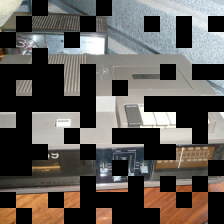

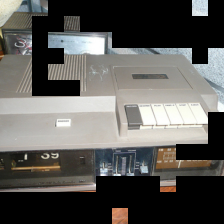

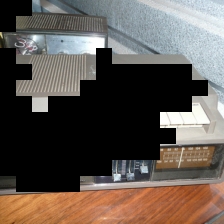

GT: tape player
Original. Transformer tape player,  ResNet tape player
Random. Transformer tape player,  ResNet crossword puzzle, crossword
Reverse. Transformer tape player,  ResNet printer
Forward. Transformer tape player,  ResNet envelope


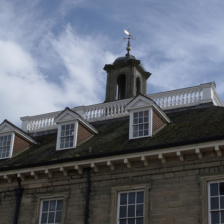

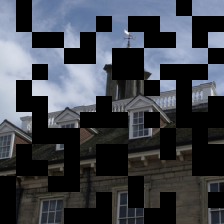

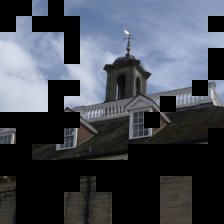

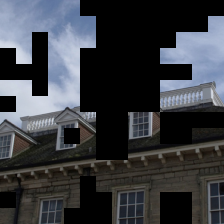

GT: tile roof
Original. Transformer dome,  ResNet monastery
Random. Transformer dome,  ResNet traffic light, traffic signal, stoplight
Reverse. Transformer dome,  ResNet church, church building
Forward. Transformer palace,  ResNet church, church building


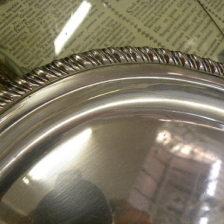

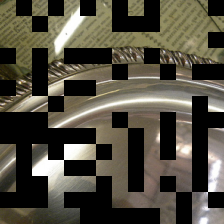

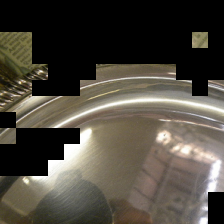

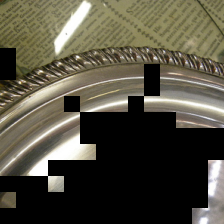

GT: tray
Original. Transformer ladle,  ResNet tray
Random. Transformer ladle,  ResNet maze, labyrinth
Reverse. Transformer ladle,  ResNet washbasin, handbasin, washbowl, lavabo, wash-hand basin
Forward. Transformer bottlecap,  ResNet coil, spiral, volute, whorl, helix


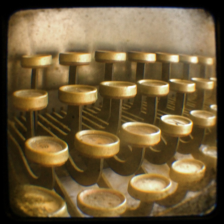

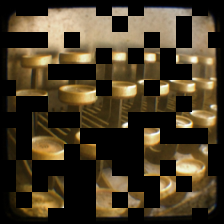

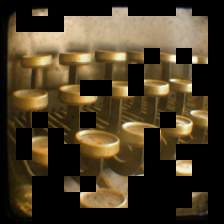

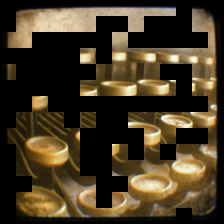

GT: typewriter keyboard
Original. Transformer typewriter keyboard,  ResNet typewriter keyboard
Random. Transformer space bar,  ResNet maze, labyrinth
Reverse. Transformer typewriter keyboard,  ResNet lampshade, lamp shade
Forward. Transformer typewriter keyboard,  ResNet candle, taper, wax light


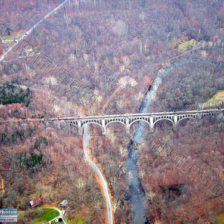

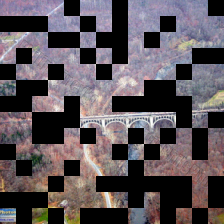

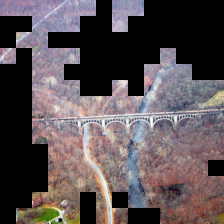

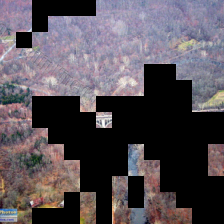

GT: viaduct
Original. Transformer valley, vale,  ResNet suspension bridge
Random. Transformer steel arch bridge,  ResNet crossword puzzle, crossword
Reverse. Transformer chainlink fence,  ResNet castle
Forward. Transformer valley, vale,  ResNet jigsaw puzzle


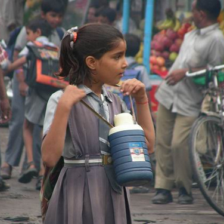

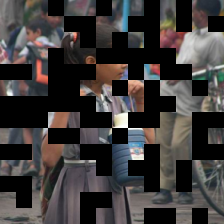

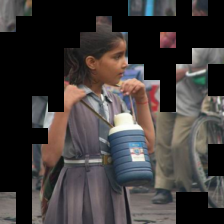

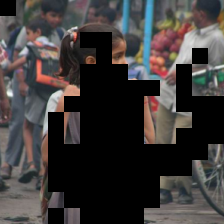

GT: water bottle
Original. Transformer milk can,  ResNet water jug
Random. Transformer milk can,  ResNet perfume, essence
Reverse. Transformer milk can,  ResNet water bottle
Forward. Transformer oxcart,  ResNet abaya


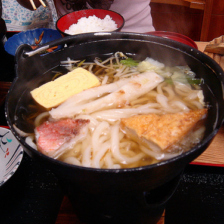

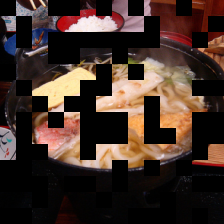

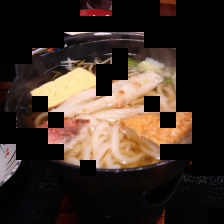

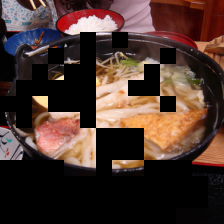

GT: wok
Original. Transformer wok,  ResNet hot pot, hotpot
Random. Transformer wok,  ResNet restaurant, eating house, eating place, eatery
Reverse. Transformer soup bowl,  ResNet wok
Forward. Transformer hot pot, hotpot,  ResNet frying pan, frypan, skillet


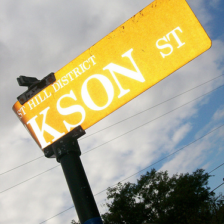

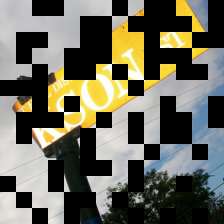

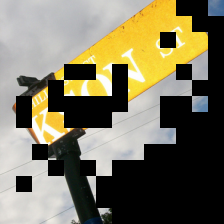

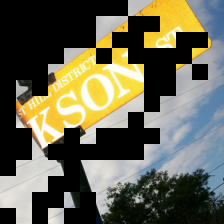

GT: street sign
Original. Transformer street sign,  ResNet street sign
Random. Transformer street sign,  ResNet traffic light, traffic signal, stoplight
Reverse. Transformer street sign,  ResNet street sign
Forward. Transformer street sign,  ResNet street sign


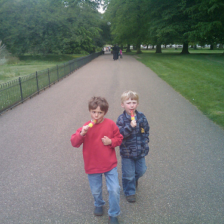

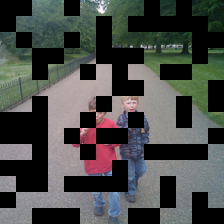

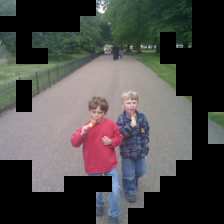

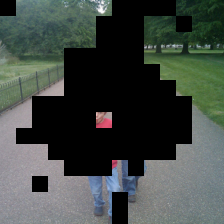

GT: ice lolly, lolly, lollipop, popsicle
Original. Transformer ice lolly, lolly, lollipop, popsicle,  ResNet knee pad
Random. Transformer West Highland white terrier,  ResNet maze, labyrinth
Reverse. Transformer ice lolly, lolly, lollipop, popsicle,  ResNet spotlight, spot
Forward. Transformer worm fence, snake fence, snake-rail fence, Virginia fence,  ResNet church, church building


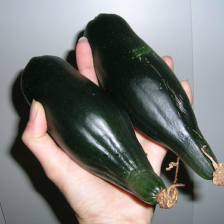

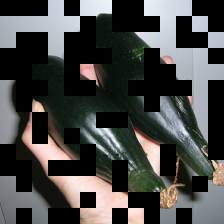

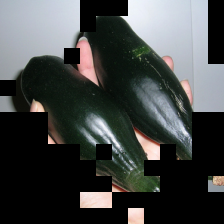

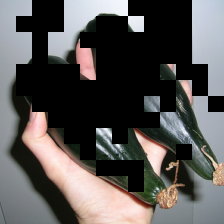

GT: zucchini, courgette
Original. Transformer zucchini, courgette,  ResNet zucchini, courgette
Random. Transformer zucchini, courgette,  ResNet digital clock
Reverse. Transformer zucchini, courgette,  ResNet zucchini, courgette
Forward. Transformer zucchini, courgette,  ResNet hook, claw


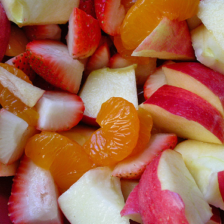

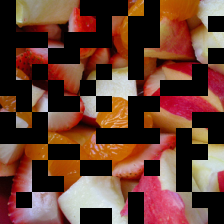

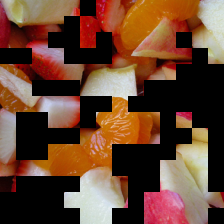

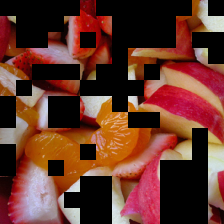

GT: strawberry
Original. Transformer orange,  ResNet strawberry
Random. Transformer orange,  ResNet envelope
Reverse. Transformer orange,  ResNet envelope
Forward. Transformer orange,  ResNet digital clock


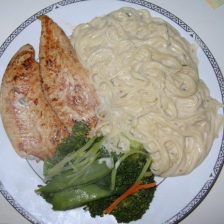

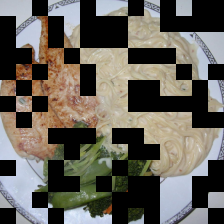

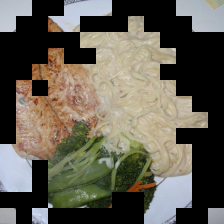

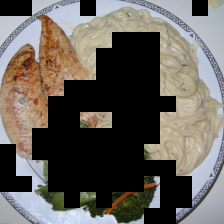

GT: carbonara
Original. Transformer cucumber, cuke,  ResNet plate
Random. Transformer plate,  ResNet crossword puzzle, crossword
Reverse. Transformer broccoli,  ResNet envelope
Forward. Transformer burrito,  ResNet mask


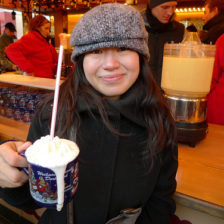

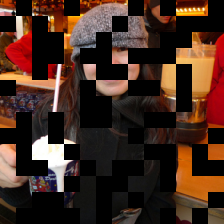

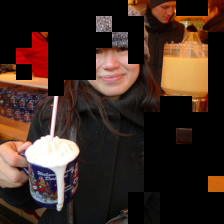

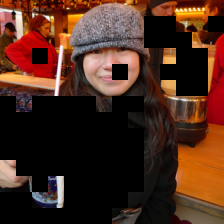

GT: eggnog
Original. Transformer ice cream, icecream,  ResNet ice cream, icecream
Random. Transformer confectionery, confectionary, candy store,  ResNet restaurant, eating house, eating place, eatery
Reverse. Transformer ice cream, icecream,  ResNet ice cream, icecream
Forward. Transformer carousel, carrousel, merry-go-round, roundabout, whirligig,  ResNet cash machine, cash dispenser, automated teller machine, automatic teller machine, automated teller, automatic teller, ATM


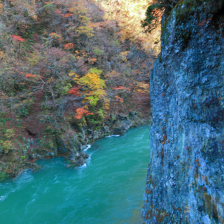

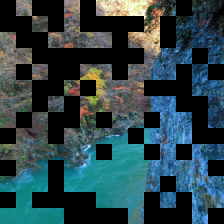

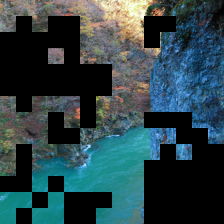

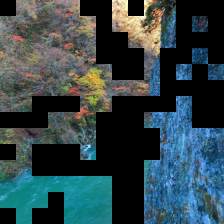

GT: valley, vale
Original. Transformer valley, vale,  ResNet valley, vale
Random. Transformer valley, vale,  ResNet maze, labyrinth
Reverse. Transformer valley, vale,  ResNet church, church building
Forward. Transformer cliff, drop, drop-off,  ResNet church, church building


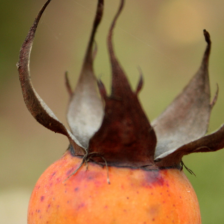

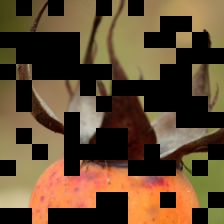

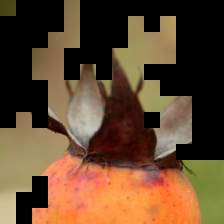

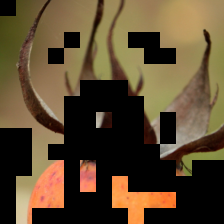

GT: hip, rose hip, rosehip
Original. Transformer pomegranate,  ResNet hip, rose hip, rosehip
Random. Transformer pomegranate,  ResNet crossword puzzle, crossword
Reverse. Transformer pomegranate,  ResNet book jacket, dust cover, dust jacket, dust wrapper
Forward. Transformer hip, rose hip, rosehip,  ResNet wall clock


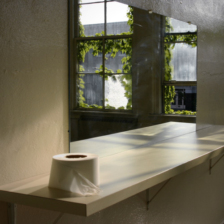

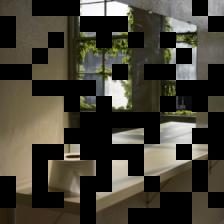

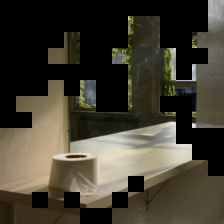

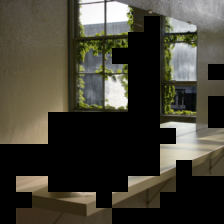

GT: toilet tissue, toilet paper, bathroom tissue
Original. Transformer window shade,  ResNet washbasin, handbasin, washbowl, lavabo, wash-hand basin
Random. Transformer window shade,  ResNet maze, labyrinth
Reverse. Transformer washbasin, handbasin, washbowl, lavabo, wash-hand basin,  ResNet washbasin, handbasin, washbowl, lavabo, wash-hand basin
Forward. Transformer window shade,  ResNet window shade


In [12]:
def display_text(pred):
    return label_map[pred]
for i in range(len(mega['image'])):
    display(torchvision.transforms.ToPILImage()(original_result['img'][i]))
    display(torchvision.transforms.ToPILImage()(random_result['img'][i]))
    display(torchvision.transforms.ToPILImage()(reverse_result['img'][i]))
    display(torchvision.transforms.ToPILImage()(forward_result['img'][i]))

    print(f"GT: {display_text(y[i].item())}")
    print(f"Original. Transformer {display_text(original_result['transformer'][i].item())},  ResNet {display_text(original_result['resnet'][i].item())}")
    print(f"Random. Transformer {display_text(random_result['transformer'][i].item())},  ResNet {display_text(random_result['resnet'][i].item())}")
    print(f"Reverse. Transformer {display_text(reverse_result['transformer'][i].item())},  ResNet {display_text(reverse_result['resnet'][i].item())}")
    print(f"Forward. Transformer {display_text(forward_result['transformer'][i].item())},  ResNet {display_text(forward_result['resnet'][i].item())}")
    
    

In [11]:
from robustness.tools.label_maps import CLASS_DICT
label_map = CLASS_DICT['ImageNet']

In [ ]:
def get_envelope(self, methods, all_saliency_maps, use_masking=True, filler_value=(0,0,0), batch_size=500, skip_factor=1):
        dl = ds_utils.get_loader(self.dataset, bsz=batch_size)
        all_accs, all_soft_labels, all_preds, all_debugs = {}, {}, {}, {}
        for m in methods:
            with torch.no_grad():
                accs, soft_labels, preds, debugs = [], [], [], []
                for i, mega in enumerate(dl):
                    x, y =  mega['image'], mega['labels']
                    print("batch", i, "method", m)
                    orig_inp = ds_utils.TRANSFORM_NORMALIZE(x).cuda()
                    reverse_orders = '_reverse' in m
                    if m == 'random':
                        patch_orders = self.pm.generate_random_patch_orders(x.shape[0])
                    else:
                        tag = m.split('_reverse')[0]
                        S = mega[f"saliency_{tag}"]
                        flattened_sal_map, patch_orders = self.pm.get_patch_ordering(S)
                    if reverse_orders:
                        if torch.is_tensor(patch_orders):
                            patch_orders = patch_orders.numpy()
                        patch_orders = patch_orders[:, ::-1].copy()
                        patch_orders = torch.tensor(patch_orders)
                    mini_accs, mini_soft_labels, mini_preds, mini_debugs = [], [], [], []
                    for nums_to_exclude in np.arange(0, self.pm.total_patches + 1, skip_factor):
                        if nums_to_exclude % 20 == 0:
                            print(nums_to_exclude)
                        if use_masking:
                            if nums_to_exclude == 0:
                                inp = x
                            else:
                                inp = self.pm.mask_images(patch_orders, nums_to_exclude, x, filler_value=filler_value)
                            inp = ds_utils.TRANSFORM_NORMALIZE(inp).cuda()
                            out = self.net(inp)
                        else:
                            inp = orig_inp
                            patch_masks = self.pm.get_patch_masks(patch_orders, nums_to_exclude).cuda()
                            out = self.net(inp, patch_mask=patch_masks)                            
                        out = ch.softmax(out, 1)
                        pred = out.argmax(-1)
                        if nums_to_exclude == 0:
                            orig_label = pred
                        mini_accs.append((pred == orig_label).int().cpu())
                        orig_label_score = torch.gather(out, 1, orig_label.unsqueeze(1)).squeeze(1)
                        mini_soft_labels.append(orig_label_score.cpu())
                        mini_preds.append(pred.cpu())
                    accs.append(torch.stack(mini_accs))
                    soft_labels.append(torch.stack(mini_soft_labels))
                    preds.append(torch.stack(mini_preds))
                    debugs.append({'patch_orders': patch_orders})
                all_accs[m] = torch.cat(accs, dim=1)
                all_soft_labels[m] = torch.cat(soft_labels, dim=1)
                all_preds[m] = torch.cat(preds, dim=1)
                all_debugs[m] = debugs
        return all_accs, all_soft_labels, all_preds, all_debugs